In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import cv2
from tensorflow.keras import layers
from keras.models import Model, Sequential
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from keras.optimizers import Adam
from keras.utils import plot_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_addons as tfa


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
import tensorflow as tf

physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) == 0:
    print("No GPU devices found. Make sure your GPU is properly installed and configured.")
else:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU configured successfully.")

GPU configured successfully.


In [3]:
import tensorflow as tf

# Check available GPUs
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    # Restrict TensorFlow to only allocate GPU memory growth
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth set to True")
    except RuntimeError as e:
        print(e)

GPU memory growth set to True


In [4]:
import tensorflow as tf

# Check if TensorFlow can access GPU
num_gpus = len(tf.config.experimental.list_physical_devices('GPU'))

if num_gpus > 0:
    print("Num GPUs Available: ", num_gpus)
    print("TensorFlow is using GPU.")
else:
    print("No GPU available. TensorFlow is using CPU.")


Num GPUs Available:  1
TensorFlow is using GPU.


In [5]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image,tf.float32)
    return image

In [6]:
path = "/kaggle/input/monumentimagenotaugmented/"
x = load(os.path.join(path, 'train/Train_3221.jpg'))
print(x.shape)

(300, 300, 3)


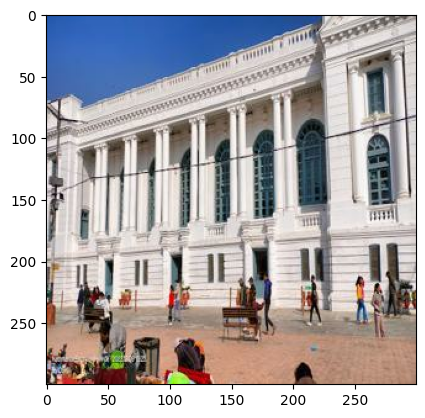

In [7]:
plt.imshow(x/255.0)

In [8]:
def normalize(real_image):
    real_image = (real_image / 255)
    return real_image

In [9]:
def random_crop(real_image):
    cropped_image = tf.image.random_crop(real_image, size = [256, 256, 3])
    return cropped_image

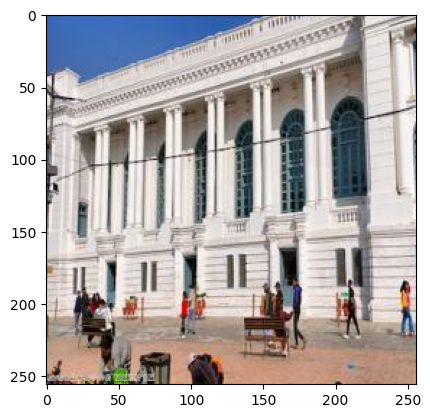

In [10]:
x_aug = random_crop(x)
plt.imshow(x_aug/255.0)

In [11]:
def resize(real_image):
    real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return real_image

In [12]:
def rotate_image(image, angles, interpolation='BILINEAR'):
    """
    Rotate an image tensor by specified angles.

    Args:
    - image: Input image tensor with shape (batch_size, height, width, channels).
    - angles: Tensor of rotation angles in radians for each image in the batch.
    - interpolation: Interpolation method ('BILINEAR' or 'NEAREST').

    Returns:
    - Rotated image tensor.
    """
    batch_size, height, width, channels = tf.unstack(tf.shape(image))

    # Coordinates of the center of the image
    center_x = tf.cast(width, tf.float32) / 2.0
    center_y = tf.cast(height, tf.float32) / 2.0

    # Define transformation matrix
    rotation_matrix = tf.reshape(tf.stack([tf.cos(angles), -tf.sin(angles), center_x * (1 - tf.cos(angles)) + center_y * tf.sin(angles),
                                           tf.sin(angles), tf.cos(angles), -center_x * tf.sin(angles) + center_y * (1 - tf.cos(angles)),
                                           0.0, 0.0, 1.0], axis=1), shape=(-1, 3, 3))

    # Apply rotation to each pixel
    rotated_image = tfa.image.transform(image, rotation_matrix, interpolation)

    return rotated_image


In [13]:
def random_jitter(real_image):
    if tf.random.uniform(()) > 0.5:
        real_image = tf.image.flip_left_right(real_image)
    return real_image

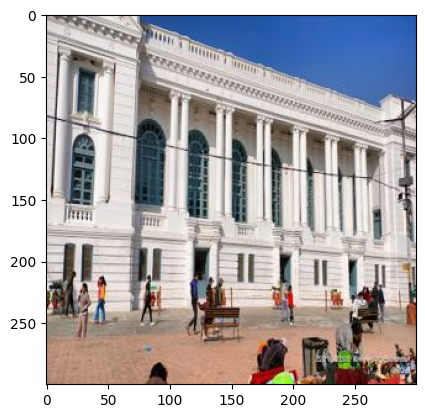

In [14]:
x_jitter = random_jitter(x)
plt.imshow(x_jitter/255.0)

In [15]:
def load_train_images(image_path):
    real_image = load(image_path)
    real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    # Define the rotation angle in radians
    rotation_angle = tf.constant(20.0 * (3.141592653589793 / 180.0), dtype=tf.float32)

    # Apply the rotation using tfa.image.rotate
    real_image = tfa.image.rotate(real_image, angles=rotation_angle)

#     # Example usage
#     angles = tf.placeholder(dtype=tf.float32, shape=(None,))
#     # Specify the rotation range in degrees
#     rotation_range = 15  # Adjust this value as needed
#     # Convert the rotation range to radians
#     rotation_range_rad = rotation_range * (np.pi / 180.0)
#     # Generate random rotation angles for each image in the batch
#     random_angles = tf.random.uniform(shape=(tf.shape(image)[0],), minval=-rotation_range_rad, maxval=rotation_range_rad)
#     # Apply custom rotation to the image with bilinear interpolation
#     real_image = rotate_image(real_image, random_angles, interpolation='BILINEAR')
    #     real_image = rotate(real_image)
    real_image = random_jitter(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [16]:
def load_test_image(image_path):
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [17]:
IMAGE_SIZE = 256
BATCH_SIZE = 32

In [18]:
# create input pipeline
train_dataset = tf.data.Dataset.list_files(path + "train/*.jpg")
train_dataset = train_dataset.map(load_train_images)
train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [19]:
test_dataset = tf.data.Dataset.list_files(path + 'val/*.jpg')
test_dataset = test_dataset.map(load_test_image)
test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [20]:
# downsample block
def downsample(filters, size,dropout=False, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
    if dropout == True :
        result.add(Dropout(0.3))
    result.add(LeakyReLU())
    return result
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print(down_result.shape)

(1, 150, 150, 3)


In [21]:
# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.3))
    result.add(ReLU())
    return result
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 300, 300, 3)


In [22]:
def generator(input_shape = (256,256,1), output_channels = 2):
    inputs = Input(shape = input_shape)
    down_stack = [
        downsample(64, 4, batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True)
    ]


    up_stack = [
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(256, 4, dropout=True),
        upsample(128, 4),
        upsample(64, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(2, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)
    return Model(inputs = inputs, outputs = x)

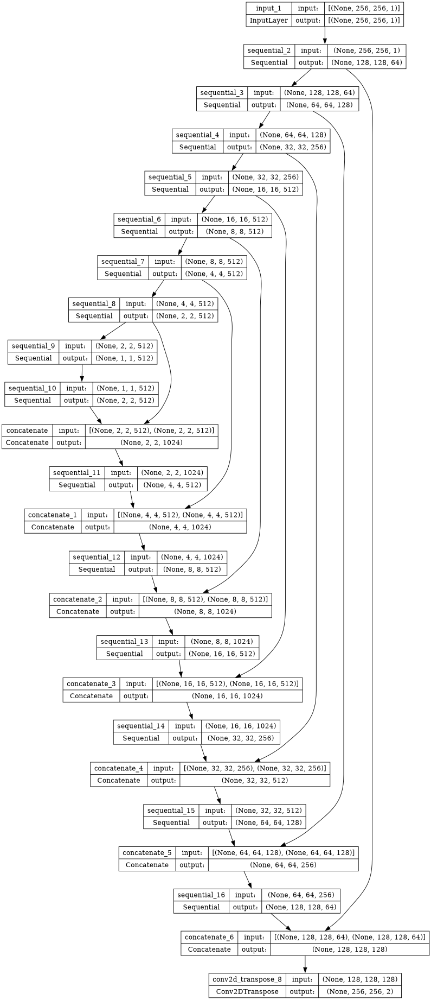

In [23]:
gen = generator()
plot_model(gen, show_shapes=True, dpi = 64)

In [24]:
def discriminator():
    init = tf.random_normal_initializer(0., 0.02)

    inp = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 1], name = "input_image")
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 2], name = "target_image")
    x = Concatenate()([inp, tar])
    down1 = downsample(64,4,False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = [inp, tar], outputs = last)

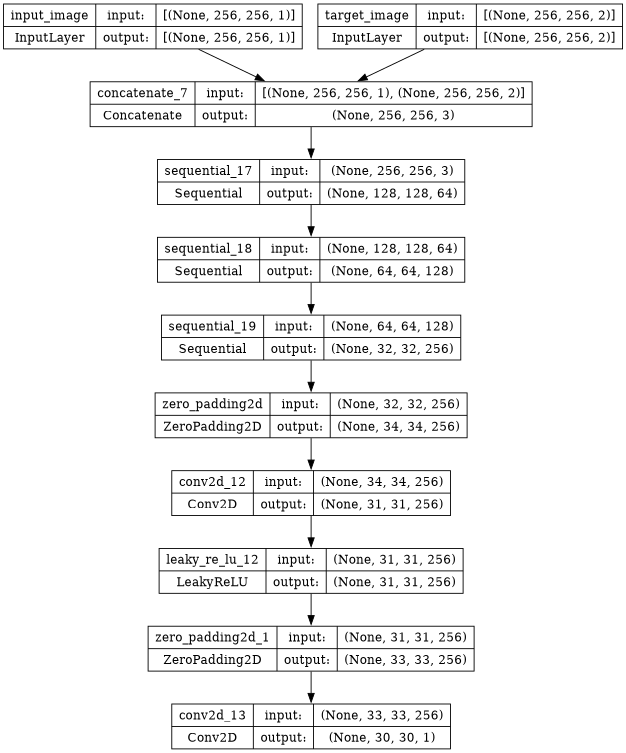

In [25]:
disc = discriminator()
plot_model(disc, show_shapes=True, dpi = 64)

In [26]:
# Function to create YUV image from Y, U, and V channels and then convert to rgb
def create_rgb_image(y_channel, uv_channel):
    # Assuming YUV format where Y, U, and V channels are separate
    # y_channel = np.array(y_channel)
    # uv_channel = np.array(uv_channel)
    u_channel, v_channel = tf.split(uv_channel, num_or_size_splits=2, axis=-1)

    # Combine Y, U, and V channels into a YUV image
    rgb_image = tf.image.yuv_to_rgb(tf.concat([y_channel, u_channel, v_channel], axis=-1))
    return rgb_image


In [27]:
LAMBDA = 50

In [28]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_function(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    return total_gen_loss, gan_loss, l1_loss

In [29]:
from keras.losses import BinaryCrossentropy
loss_function = BinaryCrossentropy(from_logits=True)

In [30]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss, real_loss, generated_loss

In [31]:
generator_optimizer = Adam(lr= 2e-4, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-4, beta_1=0.5)

In [32]:
epochs = 200

In [33]:
@tf.function
def train_step(input_image, target, epoch, training_discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training=True)
        disc_real_output = disc([input_image, target], training=True)
        disc_generated_output = disc([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss, disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

        ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        if epoch > 10:
            if training_discriminator:
                discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
                discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
            else:
                generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
                generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
        else:
            generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
            discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))

        return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values

In [34]:
@tf.function
def test_step(input_image, target):
    # Generate output using the generator
    gen_output = gen(input_image)

    # Calculate losses without updating gradients
    disc_real_output = disc([input_image, target])
    disc_generated_output = disc([input_image, gen_output])

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

    ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
    return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values


In [35]:
os.mkdir('/kaggle/working/gen_output/')

In [36]:
def display_one_random_test_image(input_, target, gen_model, epoch):
    print("Displaying one random test image...")
    img_array = np.array(input_)
    generated_output_test = gen_model(input_)
    ssim = tf.image.ssim(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)
    psnr = tf.image.psnr(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)  
    # print(input_.shape)
    input_ = np.squeeze(input_, axis=0)
    # print(type(input_), type(target))
    # print(input_.shape, input_)
    # input_.reshape((256,256))
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 4, 1)
    plt.title('Input Testing Image')
    plt.imshow(input_, cmap='gray', vmax = 1, vmin = 0)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # print(target.shape)
    target = np.squeeze(target, axis=0)
    # # print(target.shape)
    target_img = create_rgb_image(input_, target).numpy()
    # # print(type(target_img))
    # target
    # # print(target_img.shape, target_img)
    plt.subplot(1, 4, 2)
    plt.title('Target Testing Image')
    plt.imshow(target_img)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # Convert PIL Image to NumPy array
    # img_array = np.array(input_)
    # # Add batch dimension
    # # print(img_array.shape)
    # img_array = np.expand_dims(img_array, axis=0)
    # # print(img_array.shape)
    # generated_output_test = gen_model(img_array)
    # # print(generated_output_test.shape)
    # # Squeeze the singleton dimension
    generated_output_test = np.squeeze(generated_output_test, axis=0)
    # # print(generated_output_test.shape)
    generated_img = create_rgb_image(input_, generated_output_test).numpy()
    # # print(generated_img.shape, generated_img)
    plt.subplot(1, 4, 3)
    plt.title(f'Generated Output -- epoch {epoch}')
    plt.imshow(generated_img)  # Assuming images are normalized to [-1, 1]
    plt.axis('off')
    plt.savefig(f'/kaggle/working/gen_output/epoch_{epoch}.png')
    plt.show()
    print('SSIM Score: {}'.format(ssim))
    print('PSNR Score: {}'.format(psnr))

In [37]:
def display_random_test_image(gen_model, image_path, epoch):
    
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:] 

    # Display the image
    display_one_random_test_image(tf.reshape(Y_channel, (1,256,256,1)),tf.reshape(UV_channels,(1,256,256,2)), gen_model, epoch)


Displaying one random test image...


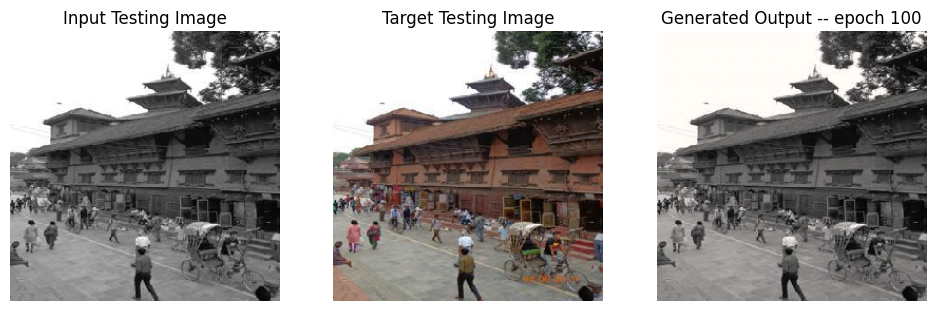

SSIM Score: 0.899446964263916
PSNR Score: 27.39803695678711


In [38]:
display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/val/Val_1000.jpg',100)

In [39]:
import random

each_epoch_train_generator_losses = []
each_epoch_train_generator_gan_losses = []
each_epoch_train_generator_l1_losses = []
each_epoch_train_discriminator_losses = []
each_epoch_train_discriminator_real_losses = []
each_epoch_train_discriminator_generated_losses = []
each_epoch_train_ssim = []
each_epoch_train_psnr = []
each_epoch_test_psnr = []
each_epoch_test_ssim = []
each_epoch_test_generator_losses = []
each_epoch_test_generator_gan_losses = []
each_epoch_test_generator_l1_losses = []
each_epoch_test_discriminator_losses = []
each_epoch_test_discriminator_real_losses = []
each_epoch_test_discriminator_generated_losses = []
train_generator_losses = []
train_generator_gan_losses = []
train_generator_l1_losses = []
train_discriminator_losses = []
train_discriminator_real_losses = []
train_discriminator_generated_losses = []
test_generator_losses = []
test_generator_gan_losses = []
test_generator_l1_losses = []
test_discriminator_losses = []
test_discriminator_real_losses = []
test_discriminator_generated_losses =[]
training_ssim = []
training_psnr = []
testing_ssim = []
testing_psnr = []
each_epoch_all_records = []
all_records = []
def fit(train_ds, epochs, test_ds, gen_model):

    # Declare global lists
    global each_epoch_train_generator_losses, each_epoch_train_generator_gan_losses, each_epoch_train_generator_l1_losses, each_epoch_train_discriminator_losses,each_epoch_train_discriminator_real_losses, each_epoch_train_discriminator_generated_losses, each_epoch_train_ssim, each_epoch_train_psnr
    global each_epoch_test_psnr, each_epoch_test_ssim, each_epoch_test_generator_losses, each_epoch_test_generator_gan_losses, each_epoch_test_generator_l1_losses, each_epoch_test_discriminator_losses, each_epoch_test_discriminator_real_losses, each_epoch_test_discriminator_generated_losses
    global train_generator_losses, train_generator_gan_losses, train_generator_l1_losses, train_discriminator_losses, train_discriminator_real_losses, train_discriminator_generated_losses, test_generator_losses, test_generator_gan_losses, test_generator_l1_losses, test_discriminator_losses, test_discriminator_real_losses, test_discriminator_generated_losses
    global training_ssim, training_psnr, testing_ssim, testing_psnr, each_epoch_all_records, all_records, LAMBDA


    # Initialize counters and flags
    consecutive_epochs_high_loss = 0
    training_discriminator = True
    stop_training = False
    min_learning_rate = 1e-7  # Set your desired minimum learning rate

    for epoch in range(epochs):
        start = time.time()
        train_count = 0
        test_count = 0

        print(f"Epoch {epoch}")

        for n, (input_, target) in train_ds.enumerate():
            if epoch > 10:
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr = train_step(input_, target, epoch, training_discriminator=training_discriminator)

            else:
                # If epoch is less than or equal to 10, train both generator and discriminator
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr  = train_step(input_, target, epoch, training_discriminator=None)

            each_epoch_train_generator_losses.append(train_gen_loss)
            each_epoch_train_generator_gan_losses.append(train_gen_gan_loss)
            each_epoch_train_generator_l1_losses.append(train_gen_l1_loss)
            each_epoch_train_discriminator_losses.append(train_disc_loss)
            each_epoch_train_discriminator_real_losses.append(train_disc_real_loss)
            each_epoch_train_discriminator_generated_losses.append(train_disc_generated_loss)
            each_epoch_train_ssim.append(tf.reduce_mean(train_ssim.numpy()))
            each_epoch_train_psnr.append(tf.reduce_mean(train_psnr.numpy()))
            train_count += 1
        #each_epoch_train_generator_losses = np.array(each_epoch_train_generator_losses)
        #print(each_epoch_train_discriminator_losses.shape())
        #print(each_epoch_train_generator_losses.shape())
        #print(each_epoch_train_ssim())
        print("Training Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f}".format(np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr)))
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print("Number of iteration {d}", train_count)

        train_generator_losses.append(np.mean(each_epoch_train_generator_losses))
        train_generator_gan_losses.append(np.mean(each_epoch_train_generator_gan_losses))
        train_generator_l1_losses.append(np.mean(each_epoch_train_generator_l1_losses))
        train_discriminator_losses.append(np.mean(each_epoch_train_discriminator_losses))
        train_discriminator_real_losses.append(np.mean(each_epoch_train_discriminator_real_losses))
        train_discriminator_generated_losses.append(np.mean(each_epoch_train_discriminator_generated_losses))
        training_ssim.append(np.mean(each_epoch_train_ssim))
        training_psnr.append(np.mean(each_epoch_train_psnr))

        # Test
        for n, (input_, target) in test_ds.enumerate():
            test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr = test_step(input_, target)
            test_count += 1

            each_epoch_test_generator_losses.append(test_gen_loss)
            each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
            each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
            each_epoch_test_discriminator_losses.append(test_disc_loss)
            each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
            each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
            each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
            each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
        print("Testing Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr)))
        print("Time taken for epoch {} is {} sec".format(epoch+1, time.time() - start))
        print(f"Number of iteration {test_count}: and Lambda = {LAMBDA}")
        LAMBDA = LAMBDA * 1.006
        test_generator_losses.append(np.mean(each_epoch_test_generator_losses))
        test_generator_gan_losses.append(np.mean(each_epoch_test_generator_gan_losses))
        test_generator_l1_losses.append(np.mean(each_epoch_test_generator_l1_losses))
        test_discriminator_losses.append(np.mean(each_epoch_test_discriminator_losses))
        test_discriminator_real_losses.append(np.mean(each_epoch_test_discriminator_real_losses))
        test_discriminator_generated_losses.append(np.mean(each_epoch_test_discriminator_generated_losses))
        testing_ssim.append(np.mean(each_epoch_test_ssim))
        testing_psnr.append(np.mean(each_epoch_test_psnr))
        each_epoch_all_records.append([np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr),LAMBDA])
        all_records.append(each_epoch_all_records)
        # emptying for next epoch
        each_epoch_test_ssim = []
        each_epoch_test_generator_losses = []
        each_epoch_test_generator_gan_losses = []
        each_epoch_test_generator_l1_losses = []
        each_epoch_test_discriminator_losses = []
        each_epoch_test_discriminator_real_losses = []
        each_epoch_test_discriminator_generated_losses = []
        each_epoch_test_psnr = []
        each_epoch_all_records = []
        #emptyling list for next iteration
        each_epoch_train_generator_losses = []
        each_epoch_train_generator_gan_losses = []
        each_epoch_train_generator_l1_losses = []
        each_epoch_train_discriminator_losses = []
        each_epoch_train_discriminator_real_losses = []
        each_epoch_train_discriminator_generated_losses = []
        each_epoch_train_ssim = []
        each_epoch_train_psnr = []
        if epoch == 0 or epoch % 5 == 0:
            # Function to display one random test image
            # def display_random_test_image(images, labels, gen_model):
            #     # Randomly select an index
            #     random_test_image_idx = random.randint(0, len(images) - 1)

            #     # Extract input and target from the selected index
            #     random_test_input = images[random_test_image_idx]
            #     random_test_target = labels[random_test_image_idx]

            #     # Display the image
            #     display_one_random_test_image(random_test_input, random_test_target, gen_model)

            # Example usage
            display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/val/Val_1000.jpg', epoch+1)
        # Check if the difference between two consecutive epochs for the last 5 epochs is less than 1
        if epoch > 10:
            # Check 1f the difference between two consecutive epochs for the last S epochs is less than 1 or 0.3
            last_epochs_losses = train_discriminator_losses[-5:] if training_discriminator else train_generator_losses[-5:]
            if all(((last_epochs_losses[i] - last_epochs_losses[i - 1])) < 0.01 if training_discriminator else ((last_epochs_losses[1] - last_epochs_losses[i - 1])) < 0.05 for i in range(1, 5)):
                consecutive_epochs_high_loss += 1
            else:
                consecutive_epochs_high_loss = 0
        
        

            # If the condition is met for 4 consecutive epochs, reduce the learning rate
        if consecutive_epochs_high_loss == 4:
            LAMBDA = LAMBDA * 1.08
            if training_discriminator:
                current_lr = generator_optimizer. learning_rate.numpy()
                new_lr = max (current_lr * 0.5, min_learning_rate)
                if new_lr > min_learning_rate:
                    generator_optimizer.learning_rate.assign(new_lr)
                    print (f"Reduced generator learning rate to {new_lr} at epoch {epoch + 1}")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Generator learning rate already at the minimum. Stopping training.")
                    stop_training = True
            else:
                current_lr = discriminator_optimizer.learning_rate.numpy()
                new_lr = max (current_lr * 0.5, min_learning_rate)
                if new_lr > min_learning_rate:
                    discriminator_optimizer.learning_rate.assign(new_lr)
                    print(f"Reduced discriminator learning rate to {new_lr} at epoch {epoch + 1}.")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Discriminator learning rate already at the minimum. Stopping training.")
                    stop_training = True

                consecutive_epochs_high_loss = 0
        # Check the flag variable
        if stop_training:
            break

In [40]:
tf.config.run_functions_eagerly(True)

Epoch 0
Training Details
Generator-- total_loss:3.12 gan_loss:0.88 l1_loss:0.04 Discriminator-- total_loss:1.41 real_loss:0.69 generated_loss:0.71 --- SSIM 0.88 PSNR 22.71
Time taken for epoch 1 is 177.7372899055481 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.71 gan_loss:0.70 l1_loss:0.10 Discriminator-- total_loss:1.42 real_loss:0.74 generated_loss:0.67 --- SSIM 0.82 PSNR 14.29
Time taken for epoch 1 is 191.8509430885315 sec
Number of iteration 70: and Lambda = 50
Displaying one random test image...


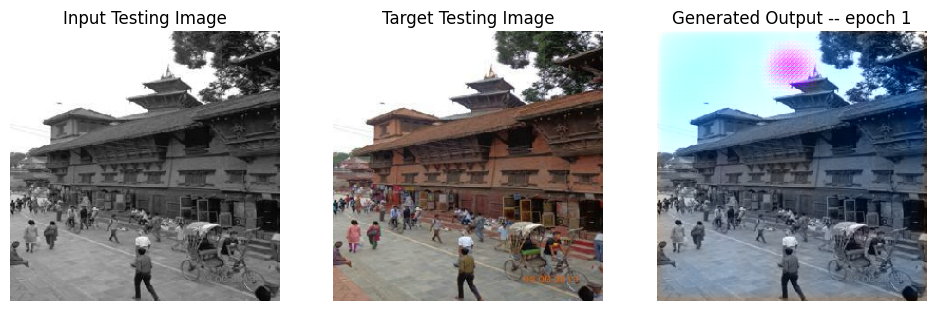

SSIM Score: 0.8494672179222107
PSNR Score: 15.743069648742676
Epoch 1
Training Details
Generator-- total_loss:2.91 gan_loss:0.95 l1_loss:0.04 Discriminator-- total_loss:1.74 real_loss:0.89 generated_loss:0.85 --- SSIM 0.93 PSNR 23.62
Time taken for epoch 2 is 171.62863326072693 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.45 gan_loss:1.09 l1_loss:0.07 Discriminator-- total_loss:1.24 real_loss:0.46 generated_loss:0.77 --- SSIM 0.94 PSNR 20.01
Time taken for epoch 2 is 185.04101657867432 sec
Number of iteration 70: and Lambda = 50.3
Epoch 2
Training Details
Generator-- total_loss:2.78 gan_loss:0.83 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.68 generated_loss:0.68 --- SSIM 0.94 PSNR 23.68
Time taken for epoch 3 is 171.7890329360962 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.27 gan_loss:0.58 l1_loss:0.09 Discriminator-- total_loss:1.82 real_loss:1.13 generated_loss:0.69 --- SSIM 0.89 PSNR 16.61
Time taken for epoch 3 i

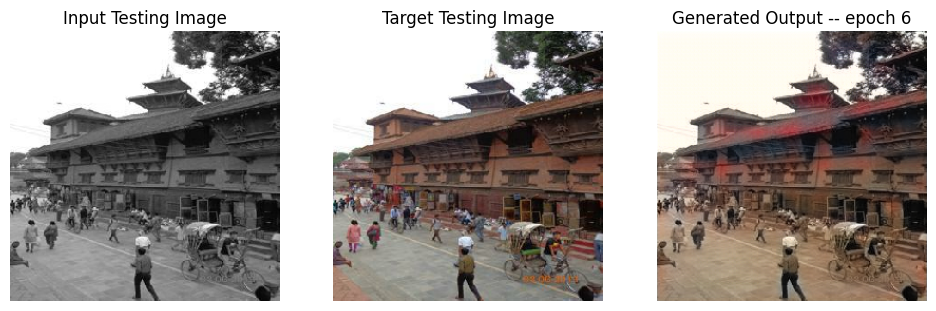

SSIM Score: 0.9600455164909363
PSNR Score: 26.992042541503906
Epoch 6
Training Details
Generator-- total_loss:2.75 gan_loss:0.77 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.68 generated_loss:0.68 --- SSIM 0.94 PSNR 23.72
Time taken for epoch 7 is 171.15548276901245 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.28 gan_loss:0.68 l1_loss:0.05 Discriminator-- total_loss:1.42 real_loss:0.76 generated_loss:0.66 --- SSIM 0.92 PSNR 20.54
Time taken for epoch 7 is 184.66952562332153 sec
Number of iteration 70: and Lambda = 51.82721697433513
Epoch 7
Training Details
Generator-- total_loss:2.80 gan_loss:0.81 l1_loss:0.04 Discriminator-- total_loss:1.43 real_loss:0.71 generated_loss:0.73 --- SSIM 0.94 PSNR 23.71
Time taken for epoch 8 is 171.6894974708557 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:24.44 gan_loss:19.12 l1_loss:0.10 Discriminator-- total_loss:17.70 real_loss:2.81 generated_loss:14.89 --- SSIM 0.78 PSNR 11.82
Time ta

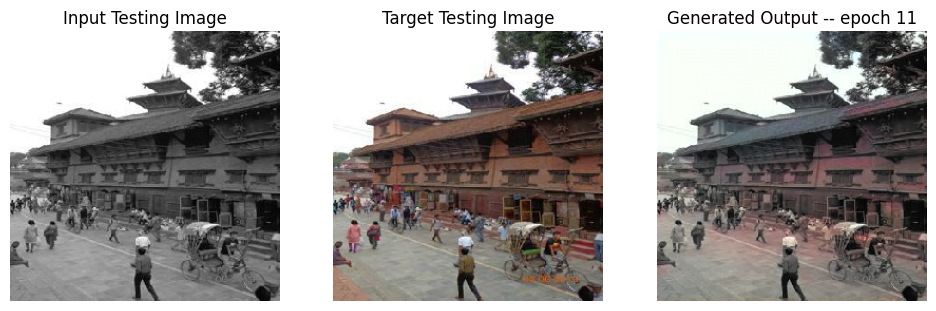

SSIM Score: 0.9718542695045471
PSNR Score: 28.085163116455078
Epoch 11
Training Details
Generator-- total_loss:5.48 gan_loss:3.62 l1_loss:0.03 Discriminator-- total_loss:0.54 real_loss:0.27 generated_loss:0.27 --- SSIM 0.95 PSNR 24.63
Time taken for epoch 12 is 116.42531204223633 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.71 gan_loss:0.57 l1_loss:0.04 Discriminator-- total_loss:1.97 real_loss:1.41 generated_loss:0.56 --- SSIM 0.95 PSNR 23.99
Time taken for epoch 12 is 129.90681791305542 sec
Number of iteration 70: and Lambda = 53.400803564707985
Epoch 12
Training Details
Generator-- total_loss:9.41 gan_loss:7.54 l1_loss:0.03 Discriminator-- total_loss:0.09 real_loss:0.04 generated_loss:0.04 --- SSIM 0.95 PSNR 24.64
Time taken for epoch 13 is 116.80734848976135 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.69 gan_loss:0.54 l1_loss:0.04 Discriminator-- total_loss:1.66 real_loss:1.36 generated_loss:0.30 --- SSIM 0.95 PSNR 23.99
Time

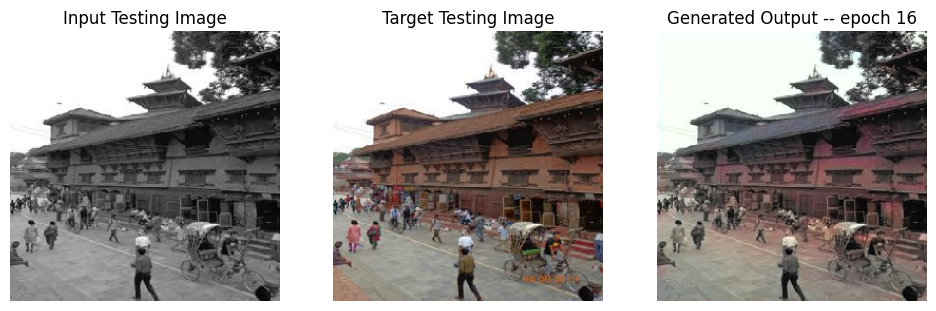

SSIM Score: 0.9725717902183533
PSNR Score: 28.62229347229004
Epoch 16
Training Details
Generator-- total_loss:10.95 gan_loss:9.04 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.95 PSNR 24.66
Time taken for epoch 17 is 116.70108199119568 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.80 gan_loss:0.60 l1_loss:0.04 Discriminator-- total_loss:1.73 real_loss:1.36 generated_loss:0.37 --- SSIM 0.95 PSNR 23.99
Time taken for epoch 17 is 130.1985719203949 sec
Number of iteration 70: and Lambda = 55.022167653120675
Epoch 17
Training Details
Generator-- total_loss:12.33 gan_loss:10.40 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.95 PSNR 24.63
Time taken for epoch 18 is 116.64256930351257 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.58 gan_loss:0.37 l1_loss:0.04 Discriminator-- total_loss:3.59 real_loss:3.34 generated_loss:0.25 --- SSIM 0.95 PSNR 23.97
Tim

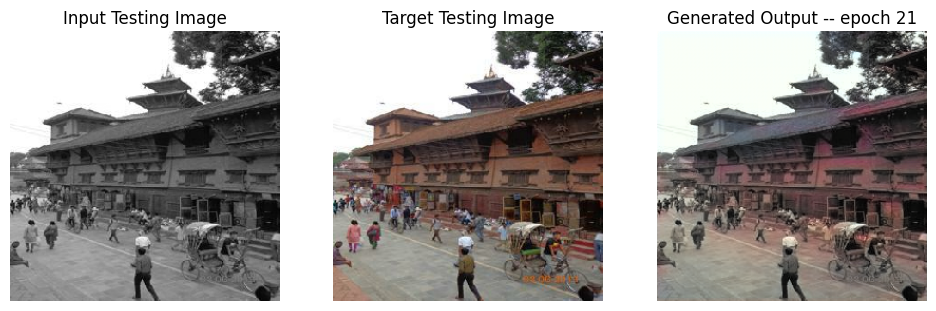

SSIM Score: 0.97259521484375
PSNR Score: 28.629453659057617
Epoch 21
Training Details
Generator-- total_loss:11.55 gan_loss:9.58 l1_loss:0.03 Discriminator-- total_loss:0.04 real_loss:0.02 generated_loss:0.02 --- SSIM 0.95 PSNR 24.64
Time taken for epoch 22 is 116.06659603118896 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.94 gan_loss:0.67 l1_loss:0.04 Discriminator-- total_loss:1.70 real_loss:1.41 generated_loss:0.29 --- SSIM 0.95 PSNR 23.99
Time taken for epoch 22 is 129.53574085235596 sec
Number of iteration 70: and Lambda = 56.69275986792305
Epoch 22
Training Details
Generator-- total_loss:12.44 gan_loss:10.46 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.95 PSNR 24.64
Time taken for epoch 23 is 116.76431441307068 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.10 gan_loss:0.81 l1_loss:0.04 Discriminator-- total_loss:1.54 real_loss:1.19 generated_loss:0.35 --- SSIM 0.95 PSNR 23.99
Time

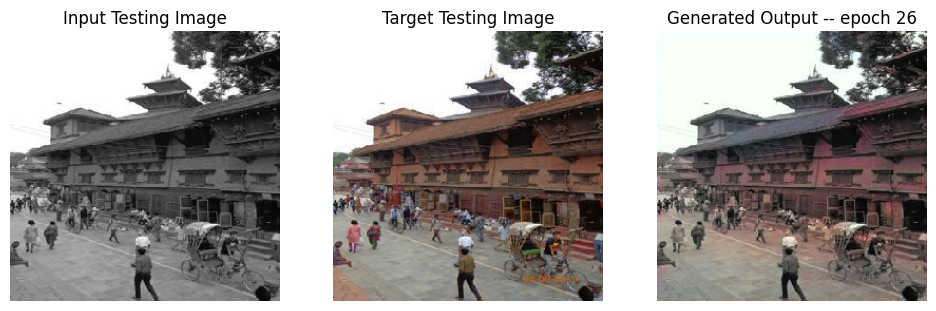

SSIM Score: 0.9725514054298401
PSNR Score: 28.611799240112305
Epoch 26
Training Details
Generator-- total_loss:10.93 gan_loss:8.90 l1_loss:0.03 Discriminator-- total_loss:0.03 real_loss:0.01 generated_loss:0.01 --- SSIM 0.95 PSNR 24.66
Time taken for epoch 27 is 117.16968035697937 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.00 gan_loss:0.67 l1_loss:0.04 Discriminator-- total_loss:2.49 real_loss:2.22 generated_loss:0.26 --- SSIM 0.95 PSNR 24.00
Time taken for epoch 27 is 130.6179563999176 sec
Number of iteration 70: and Lambda = 58.41407488168443
Epoch 27
Training Details
Generator-- total_loss:11.40 gan_loss:9.35 l1_loss:0.03 Discriminator-- total_loss:0.03 real_loss:0.02 generated_loss:0.01 --- SSIM 0.95 PSNR 24.66
Time taken for epoch 28 is 116.82013773918152 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.27 gan_loss:0.92 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.97 generated_loss:0.39 --- SSIM 0.95 PSNR 24.01
Time

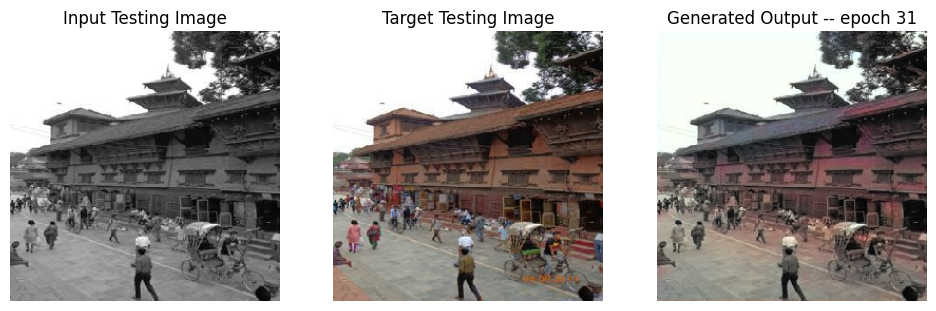

SSIM Score: 0.9725649356842041
PSNR Score: 28.613393783569336
Epoch 31
Training Details
Generator-- total_loss:12.74 gan_loss:10.64 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.00 --- SSIM 0.95 PSNR 24.65
Time taken for epoch 32 is 116.77074480056763 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.18 gan_loss:0.77 l1_loss:0.04 Discriminator-- total_loss:3.01 real_loss:2.59 generated_loss:0.42 --- SSIM 0.95 PSNR 24.00
Time taken for epoch 32 is 130.2329285144806 sec
Number of iteration 70: and Lambda = 60.18765274847154
Reduced generator learning rate to 0.0005000000237487257 at epoch 32
Epoch 32
Training Details
Generator-- total_loss:2.20 gan_loss:0.04 l1_loss:0.03 Discriminator-- total_loss:21.74 real_loss:21.74 generated_loss:0.00 --- SSIM 0.95 PSNR 24.88
Time taken for epoch 33 is 106.91191840171814 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.50 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_los

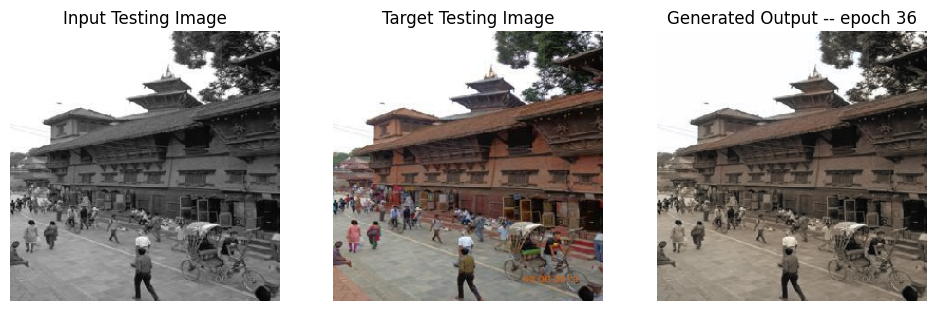

SSIM Score: 0.9792889952659607
PSNR Score: 30.46078872680664
Epoch 36
Training Details
Generator-- total_loss:2.09 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:21.74 real_loss:21.74 generated_loss:0.00 --- SSIM 0.96 PSNR 25.47
Time taken for epoch 37 is 106.71594190597534 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.54 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:18.13 real_loss:18.13 generated_loss:0.00 --- SSIM 0.95 PSNR 24.51
Time taken for epoch 37 is 120.16529273986816 sec
Number of iteration 70: and Lambda = 66.97628670426741
Epoch 37
Training Details
Generator-- total_loss:2.10 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:21.92 real_loss:21.92 generated_loss:0.00 --- SSIM 0.96 PSNR 25.58
Time taken for epoch 38 is 107.73436999320984 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.50 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:19.58 real_loss:19.58 generated_loss:0.00 --- SSIM 0.95 PSNR 24.6

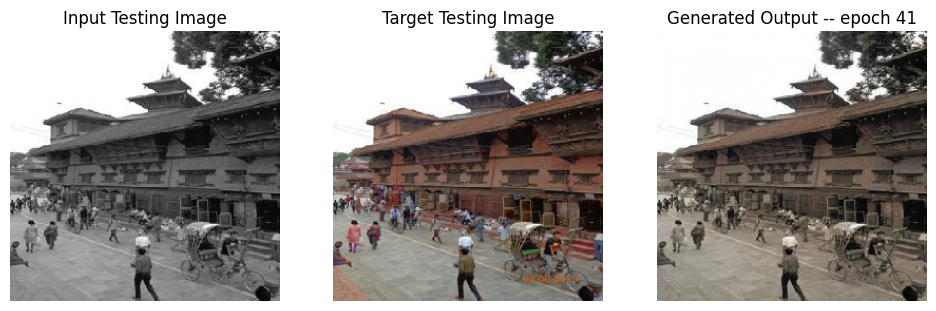

SSIM Score: 0.9796380996704102
PSNR Score: 30.748062133789062
Epoch 41
Training Details
Generator-- total_loss:10.12 gan_loss:7.82 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.70
Time taken for epoch 42 is 115.27554035186768 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.79 gan_loss:0.12 l1_loss:0.04 Discriminator-- total_loss:2.78 real_loss:2.70 generated_loss:0.09 --- SSIM 0.96 PSNR 24.94
Time taken for epoch 42 is 128.5371651649475 sec
Number of iteration 70: and Lambda = 74.53061842166863
Epoch 42
Training Details
Generator-- total_loss:11.17 gan_loss:8.87 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.71
Time taken for epoch 43 is 115.76809692382812 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.78 gan_loss:0.10 l1_loss:0.04 Discriminator-- total_loss:3.01 real_loss:2.94 generated_loss:0.07 --- SSIM 0.96 PSNR 24.95
Time

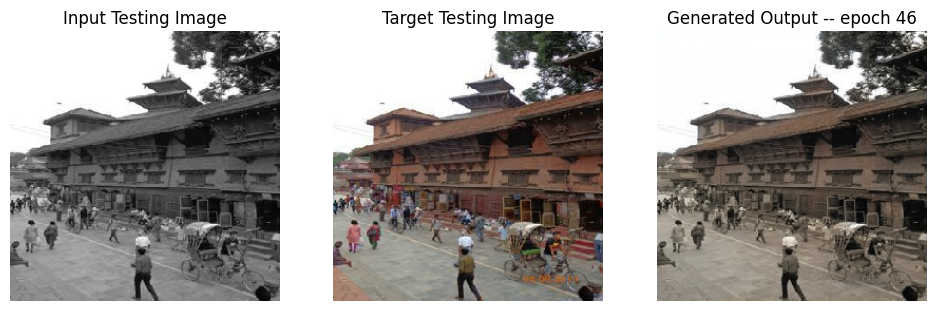

SSIM Score: 0.9796505570411682
PSNR Score: 30.754343032836914
Epoch 46
Training Details
Generator-- total_loss:13.29 gan_loss:10.93 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.72
Time taken for epoch 47 is 115.57912063598633 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.81 gan_loss:0.06 l1_loss:0.04 Discriminator-- total_loss:3.76 real_loss:3.71 generated_loss:0.05 --- SSIM 0.96 PSNR 24.95
Time taken for epoch 47 is 128.72500014305115 sec
Number of iteration 70: and Lambda = 76.79352946662425
Reduced generator learning rate to 0.0002500000118743628 at epoch 47
Epoch 47
Training Details
Generator-- total_loss:2.69 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:14.26 real_loss:14.26 generated_loss:0.00 --- SSIM 0.96 PSNR 25.34
Time taken for epoch 48 is 106.23356604576111 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.13 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_lo

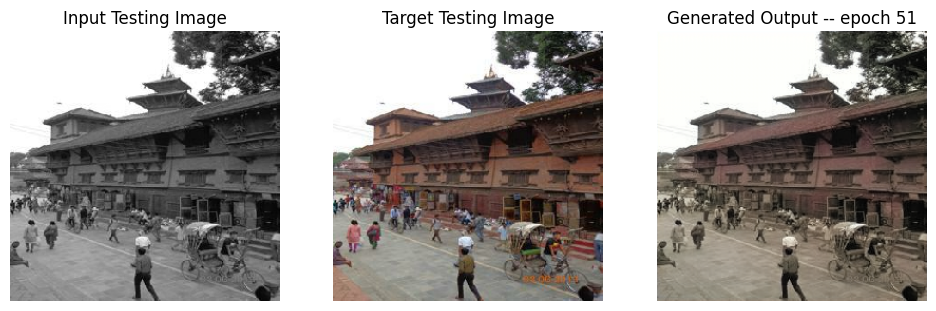

SSIM Score: 0.9795970320701599
PSNR Score: 30.824203491210938
Epoch 51
Training Details
Generator-- total_loss:2.64 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:17.15 real_loss:17.15 generated_loss:0.00 --- SSIM 0.96 PSNR 25.80
Time taken for epoch 52 is 105.54549026489258 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.09 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.19 real_loss:14.19 generated_loss:0.00 --- SSIM 0.96 PSNR 25.04
Time taken for epoch 52 is 118.68536353111267 sec
Number of iteration 70: and Lambda = 85.45515918495177
Epoch 52
Training Details
Generator-- total_loss:2.60 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:17.25 real_loss:17.25 generated_loss:0.00 --- SSIM 0.96 PSNR 25.96
Time taken for epoch 53 is 105.80610275268555 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.29 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.25 real_loss:14.25 generated_loss:0.00 --- SSIM 0.95 PSNR 24.

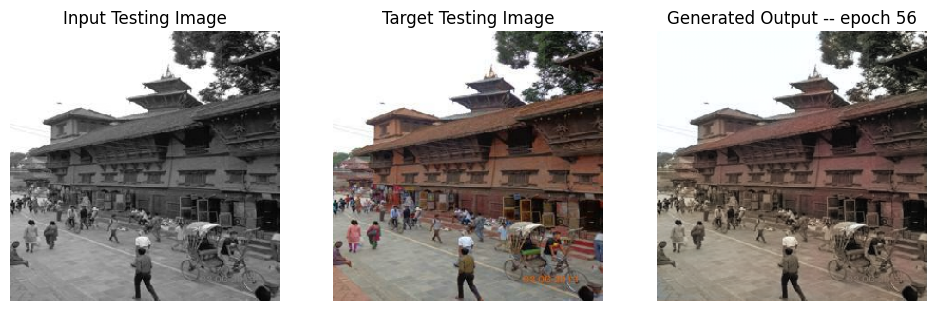

SSIM Score: 0.9793369770050049
PSNR Score: 30.601543426513672
Epoch 56
Training Details
Generator-- total_loss:2.64 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:17.30 real_loss:17.30 generated_loss:0.00 --- SSIM 0.96 PSNR 26.04
Time taken for epoch 57 is 106.04052972793579 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.06 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:16.70 real_loss:16.70 generated_loss:0.00 --- SSIM 0.96 PSNR 25.27
Time taken for epoch 57 is 119.2766580581665 sec
Number of iteration 70: and Lambda = 88.04976295536467
Epoch 57
Training Details
Generator-- total_loss:2.65 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:17.03 real_loss:17.03 generated_loss:0.00 --- SSIM 0.96 PSNR 26.06
Time taken for epoch 58 is 106.75872111320496 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.16 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:15.57 real_loss:15.56 generated_loss:0.00 --- SSIM 0.96 PSNR 25.0

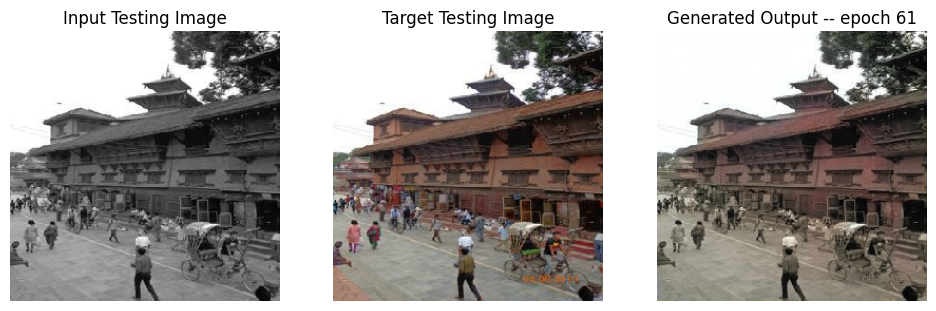

SSIM Score: 0.9795792698860168
PSNR Score: 30.940397262573242
Epoch 61
Training Details
Generator-- total_loss:12.69 gan_loss:9.77 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 62 is 115.87359261512756 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.64 gan_loss:0.16 l1_loss:0.04 Discriminator-- total_loss:2.96 real_loss:2.87 generated_loss:0.09 --- SSIM 0.96 PSNR 25.11
Time taken for epoch 62 is 129.0699520111084 sec
Number of iteration 70: and Lambda = 97.98099607881863
Epoch 62
Training Details
Generator-- total_loss:13.33 gan_loss:10.40 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 63 is 115.84107661247253 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.60 gan_loss:0.10 l1_loss:0.04 Discriminator-- total_loss:3.55 real_loss:3.49 generated_loss:0.06 --- SSIM 0.96 PSNR 25.10
Tim

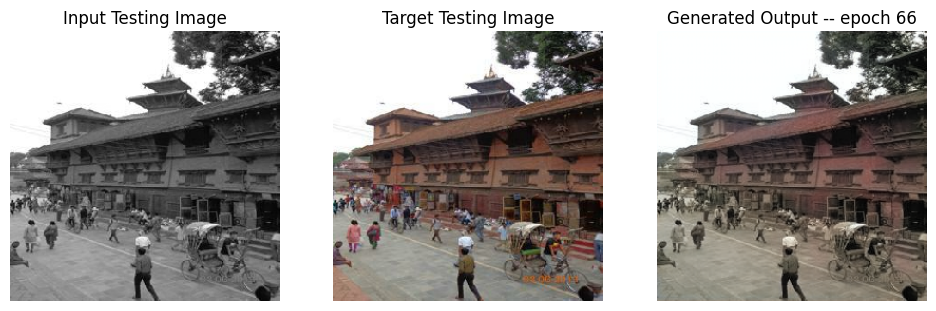

SSIM Score: 0.9795718193054199
PSNR Score: 30.93795394897461
Epoch 66
Training Details
Generator-- total_loss:15.08 gan_loss:12.07 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 67 is 115.15941500663757 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.71 gan_loss:0.13 l1_loss:0.04 Discriminator-- total_loss:3.68 real_loss:3.59 generated_loss:0.09 --- SSIM 0.96 PSNR 25.10
Time taken for epoch 67 is 128.50151371955872 sec
Number of iteration 70: and Lambda = 100.95591139440185
Epoch 67
Training Details
Generator-- total_loss:15.69 gan_loss:12.67 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.09
Time taken for epoch 68 is 115.31569766998291 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.70 gan_loss:0.09 l1_loss:0.04 Discriminator-- total_loss:4.17 real_loss:4.10 generated_loss:0.07 --- SSIM 0.96 PSNR 25.11
T

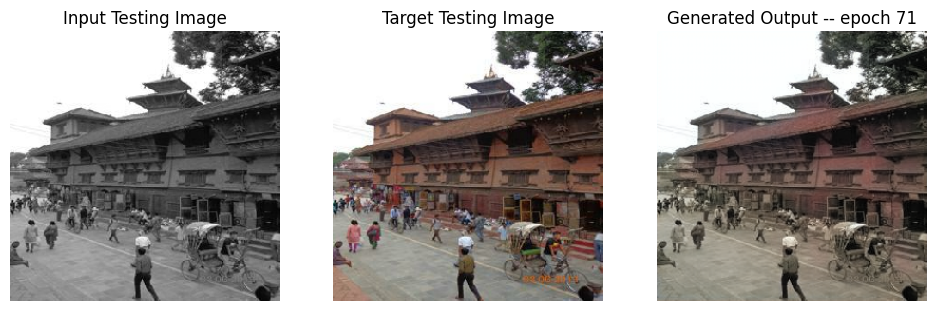

SSIM Score: 0.9795916676521301
PSNR Score: 30.94467544555664
Epoch 71
Training Details
Generator-- total_loss:15.64 gan_loss:12.55 l1_loss:0.03 Discriminator-- total_loss:0.05 real_loss:0.03 generated_loss:0.02 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 72 is 115.12839126586914 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.85 gan_loss:0.15 l1_loss:0.04 Discriminator-- total_loss:3.90 real_loss:3.84 generated_loss:0.07 --- SSIM 0.96 PSNR 25.09
Time taken for epoch 72 is 128.42171263694763 sec
Number of iteration 70: and Lambda = 104.02115158408384
Epoch 72
Training Details
Generator-- total_loss:15.22 gan_loss:12.11 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.09
Time taken for epoch 73 is 115.0420241355896 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.79 gan_loss:0.07 l1_loss:0.04 Discriminator-- total_loss:4.59 real_loss:4.55 generated_loss:0.04 --- SSIM 0.96 PSNR 25.10
Ti

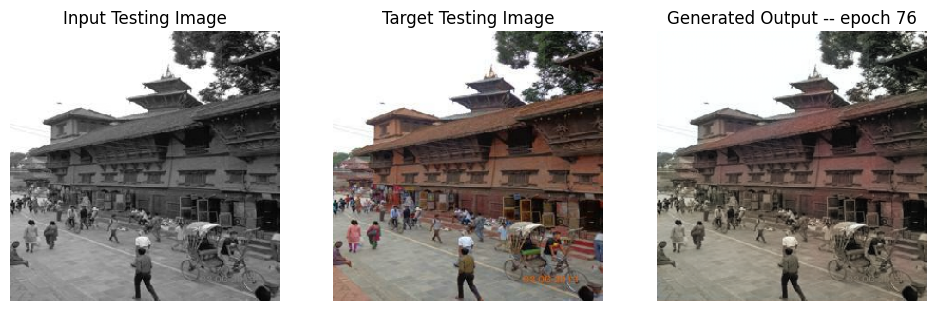

SSIM Score: 0.9795575141906738
PSNR Score: 30.94532585144043
Epoch 76
Training Details
Generator-- total_loss:17.09 gan_loss:13.89 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 77 is 114.97759222984314 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.89 gan_loss:0.09 l1_loss:0.04 Discriminator-- total_loss:4.50 real_loss:4.45 generated_loss:0.04 --- SSIM 0.96 PSNR 25.11
Time taken for epoch 77 is 128.2999827861786 sec
Number of iteration 70: and Lambda = 107.17945910672996
Epoch 77
Training Details
Generator-- total_loss:17.40 gan_loss:14.19 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 78 is 114.98108959197998 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.92 gan_loss:0.09 l1_loss:0.04 Discriminator-- total_loss:4.52 real_loss:4.47 generated_loss:0.05 --- SSIM 0.96 PSNR 25.10
Ti

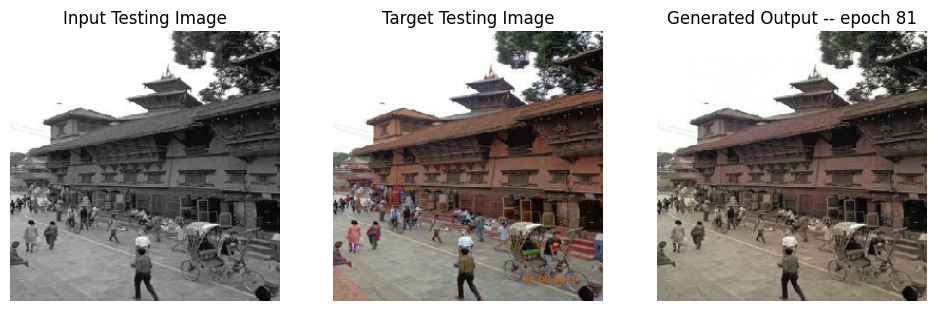

SSIM Score: 0.9792029857635498
PSNR Score: 30.54572868347168
Epoch 81
Training Details
Generator-- total_loss:3.53 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.98 real_loss:11.98 generated_loss:0.00 --- SSIM 0.96 PSNR 26.04
Time taken for epoch 82 is 105.66448163986206 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.15 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:14.12 real_loss:14.12 generated_loss:0.00 --- SSIM 0.96 PSNR 25.23
Time taken for epoch 82 is 118.82060599327087 sec
Number of iteration 70: and Lambda = 119.26835246325415
Epoch 82
Training Details
Generator-- total_loss:3.55 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.34 real_loss:12.34 generated_loss:0.00 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 83 is 106.13040208816528 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.27 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.53 real_loss:14.53 generated_loss:0.00 --- SSIM 0.96 PSNR 25.

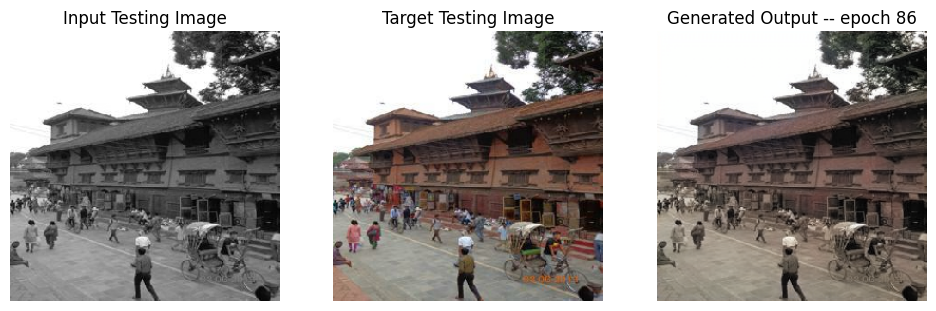

SSIM Score: 0.9794796109199524
PSNR Score: 30.80113410949707
Epoch 86
Training Details
Generator-- total_loss:3.61 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.41 real_loss:12.41 generated_loss:0.00 --- SSIM 0.96 PSNR 26.11
Time taken for epoch 87 is 105.72096657752991 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.77 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.81 real_loss:14.81 generated_loss:0.00 --- SSIM 0.95 PSNR 24.39
Time taken for epoch 87 is 118.87764000892639 sec
Number of iteration 70: and Lambda = 122.88959803746621
Reduced discriminator learning rate to 0.0001250000059371814 at epoch 87.
Epoch 87
Training Details
Generator-- total_loss:11.81 gan_loss:7.88 l1_loss:0.03 Discriminator-- total_loss:0.09 real_loss:0.06 generated_loss:0.03 --- SSIM 0.96 PSNR 26.11
Time taken for epoch 88 is 114.94296050071716 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.70 gan_loss:0.06 l1_loss:0.03 Discriminator-- to

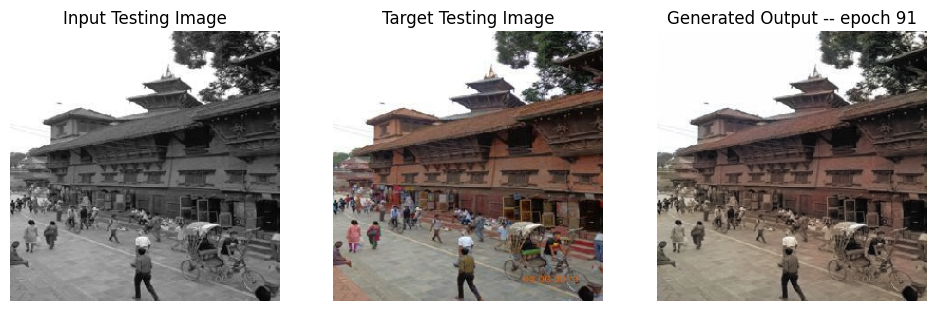

SSIM Score: 0.9796929955482483
PSNR Score: 30.648813247680664
Epoch 91
Training Details
Generator-- total_loss:14.77 gan_loss:10.75 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.12
Time taken for epoch 92 is 114.92045593261719 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.77 gan_loss:0.03 l1_loss:0.03 Discriminator-- total_loss:4.83 real_loss:4.79 generated_loss:0.04 --- SSIM 0.96 PSNR 25.24
Time taken for epoch 92 is 127.99948334693909 sec
Number of iteration 70: and Lambda = 136.75045587051127
Epoch 92
Training Details
Generator-- total_loss:15.41 gan_loss:11.36 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.11
Time taken for epoch 93 is 114.94808959960938 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.78 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:5.44 real_loss:5.41 generated_loss:0.03 --- SSIM 0.96 PSNR 25.25


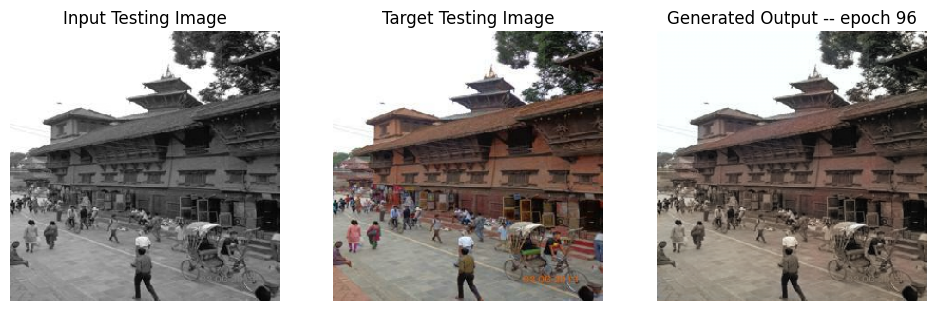

SSIM Score: 0.9790759086608887
PSNR Score: 30.806570053100586
Epoch 96
Training Details
Generator-- total_loss:4.44 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:8.64 real_loss:8.64 generated_loss:0.00 --- SSIM 0.96 PSNR 25.98
Time taken for epoch 97 is 106.02969670295715 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.36 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:13.20 real_loss:13.20 generated_loss:0.00 --- SSIM 0.96 PSNR 24.97
Time taken for epoch 97 is 119.41365933418274 sec
Number of iteration 70: and Lambda = 152.1746956572455
Epoch 97
Training Details
Generator-- total_loss:4.46 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:8.92 real_loss:8.92 generated_loss:0.00 --- SSIM 0.96 PSNR 26.01
Time taken for epoch 98 is 107.08016729354858 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.52 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:12.48 real_loss:12.48 generated_loss:0.00 --- SSIM 0.95 PSNR 24.85
T

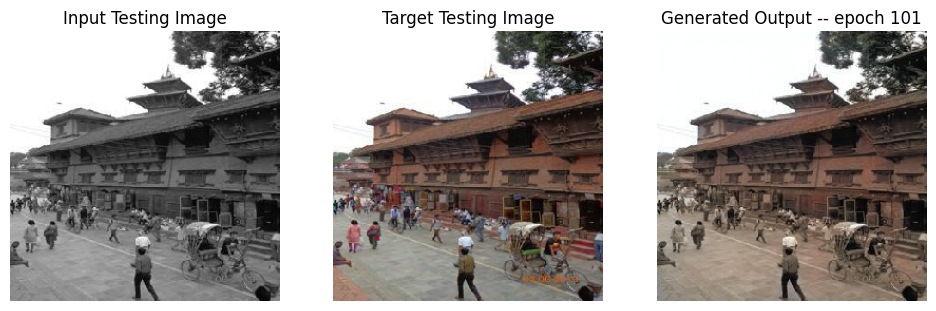

SSIM Score: 0.9797614216804504
PSNR Score: 30.513139724731445
Epoch 101
Training Details
Generator-- total_loss:4.54 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:9.24 real_loss:9.24 generated_loss:0.00 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 102 is 106.38679432868958 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.43 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:13.20 real_loss:13.20 generated_loss:0.00 --- SSIM 0.96 PSNR 25.14
Time taken for epoch 102 is 119.75278210639954 sec
Number of iteration 70: and Lambda = 156.79504910201746
Reduced discriminator learning rate to 6.25000029685907e-05 at epoch 102.
Epoch 102
Training Details
Generator-- total_loss:12.94 gan_loss:8.02 l1_loss:0.03 Discriminator-- total_loss:0.10 real_loss:0.06 generated_loss:0.04 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 103 is 115.41957759857178 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.15 gan_loss:0.27 l1_loss:0.03 Discriminator-

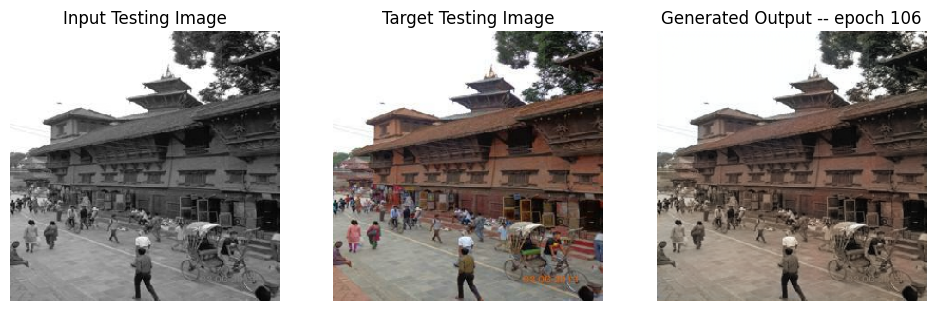

SSIM Score: 0.9802770614624023
PSNR Score: 30.866037368774414
Epoch 106
Training Details
Generator-- total_loss:15.70 gan_loss:10.66 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 107 is 114.93117928504944 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.14 gan_loss:0.11 l1_loss:0.03 Discriminator-- total_loss:3.56 real_loss:3.47 generated_loss:0.09 --- SSIM 0.96 PSNR 25.18
Time taken for epoch 107 is 128.0481927394867 sec
Number of iteration 70: and Lambda = 174.4801414062969
Epoch 107
Training Details
Generator-- total_loss:16.09 gan_loss:11.01 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 108 is 114.88695287704468 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.20 gan_loss:0.13 l1_loss:0.03 Discriminator-- total_loss:3.35 real_loss:3.24 generated_loss:0.11 --- SSIM 0.96 PSNR 25.

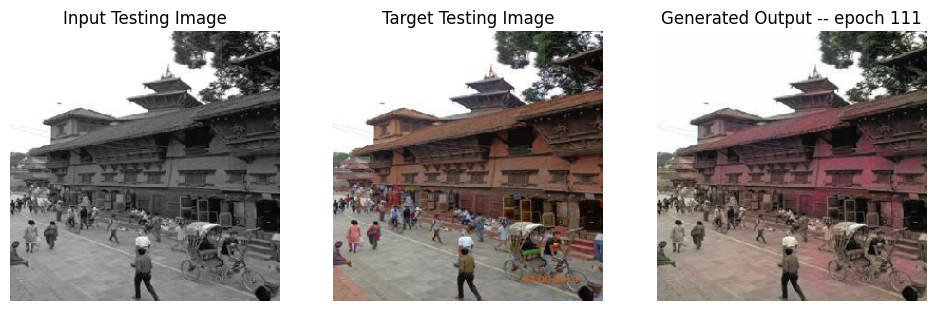

SSIM Score: 0.976020872592926
PSNR Score: 29.5635986328125
Epoch 111
Training Details
Generator-- total_loss:5.78 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.48 real_loss:8.48 generated_loss:0.00 --- SSIM 0.96 PSNR 25.86
Time taken for epoch 112 is 105.65525698661804 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.76 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:10.97 real_loss:10.97 generated_loss:0.00 --- SSIM 0.96 PSNR 25.10
Time taken for epoch 112 is 118.89981579780579 sec
Number of iteration 70: and Lambda = 194.15995542916443
Epoch 112
Training Details
Generator-- total_loss:5.79 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.37 real_loss:8.37 generated_loss:0.00 --- SSIM 0.96 PSNR 25.89
Time taken for epoch 113 is 105.41968131065369 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.03 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.22 real_loss:11.22 generated_loss:0.00 --- SSIM 0.95 PSNR 24.8

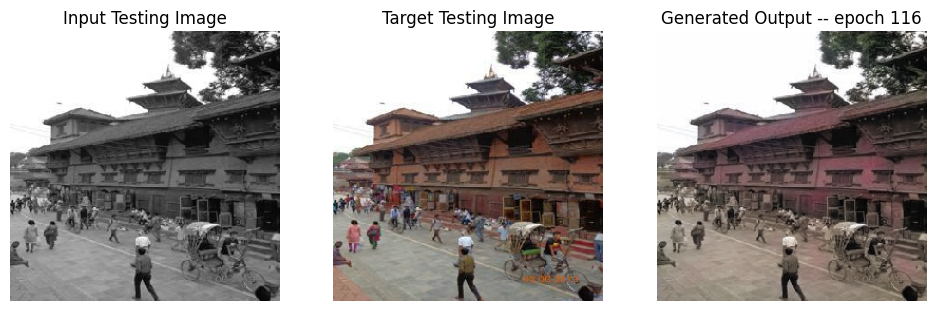

SSIM Score: 0.9775694012641907
PSNR Score: 30.32416534423828
Epoch 116
Training Details
Generator-- total_loss:5.85 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:9.72 real_loss:9.72 generated_loss:0.00 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 117 is 105.45666790008545 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.00 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.45 real_loss:11.45 generated_loss:0.00 --- SSIM 0.95 PSNR 25.16
Time taken for epoch 117 is 118.63769578933716 sec
Number of iteration 70: and Lambda = 200.0550723211639
Reduced discriminator learning rate to 3.125000148429535e-05 at epoch 117.
Epoch 117
Training Details
Generator-- total_loss:11.79 gan_loss:5.49 l1_loss:0.03 Discriminator-- total_loss:0.31 real_loss:0.19 generated_loss:0.13 --- SSIM 0.96 PSNR 26.13
Time taken for epoch 118 is 114.87402510643005 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.96 gan_loss:0.40 l1_loss:0.03 Discriminator--

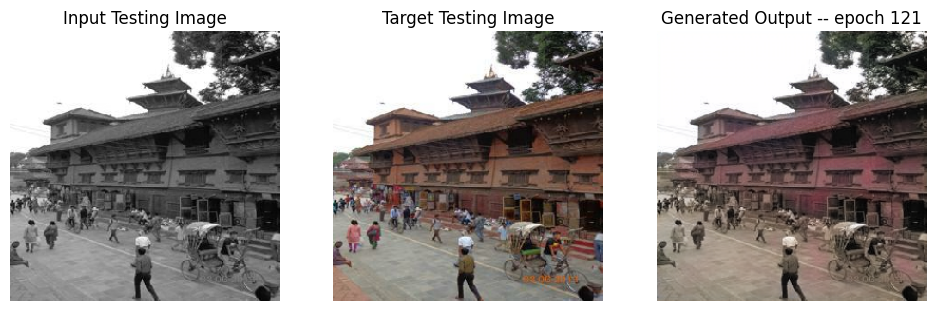

SSIM Score: 0.9777615666389465
PSNR Score: 30.296445846557617
Epoch 121
Training Details
Generator-- total_loss:14.10 gan_loss:7.63 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.12
Time taken for epoch 122 is 114.70929026603699 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.06 gan_loss:0.31 l1_loss:0.03 Discriminator-- total_loss:2.53 real_loss:2.27 generated_loss:0.25 --- SSIM 0.95 PSNR 25.18
Time taken for epoch 122 is 127.82487368583679 sec
Number of iteration 70: and Lambda = 222.6195119523994
Epoch 122
Training Details
Generator-- total_loss:14.51 gan_loss:8.00 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.11
Time taken for epoch 123 is 114.66172504425049 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.10 gan_loss:0.30 l1_loss:0.03 Discriminator-- total_loss:2.48 real_loss:2.25 generated_loss:0.23 --- SSIM 0.95 PSNR 25.1

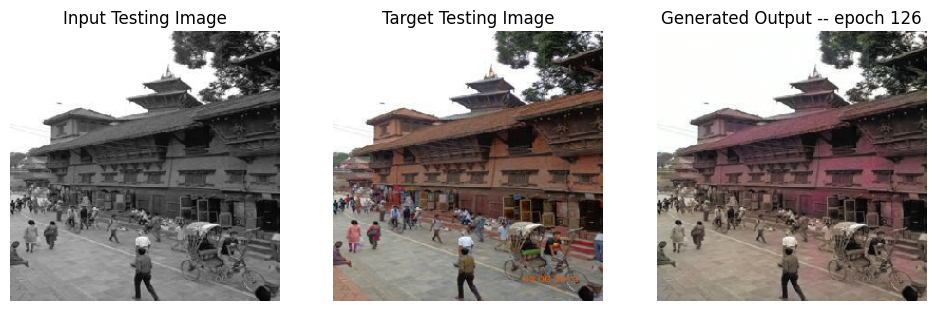

SSIM Score: 0.977203905582428
PSNR Score: 30.052730560302734
Epoch 126
Training Details
Generator-- total_loss:7.22 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.25 real_loss:7.24 generated_loss:0.00 --- SSIM 0.96 PSNR 26.04
Time taken for epoch 127 is 106.04894614219666 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.65 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:9.64 real_loss:9.64 generated_loss:0.00 --- SSIM 0.96 PSNR 25.09
Time taken for epoch 127 is 119.42930102348328 sec
Number of iteration 70: and Lambda = 247.72902044874363
Epoch 127
Training Details
Generator-- total_loss:7.26 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.52 real_loss:7.52 generated_loss:0.00 --- SSIM 0.96 PSNR 26.05
Time taken for epoch 128 is 105.3698410987854 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.65 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:9.76 real_loss:9.76 generated_loss:0.00 --- SSIM 0.96 PSNR 25.15
T

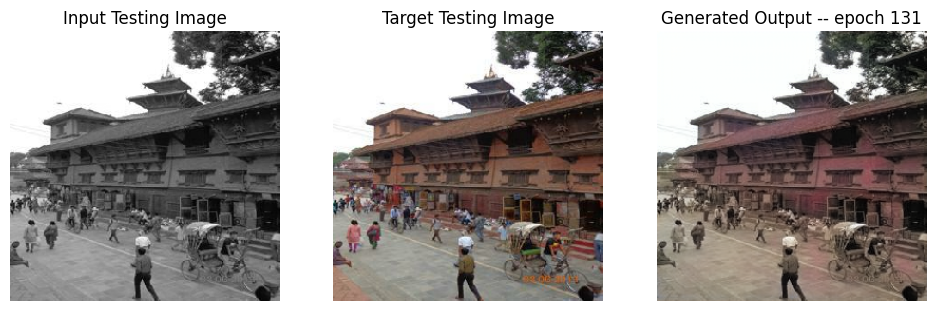

SSIM Score: 0.9785416722297668
PSNR Score: 30.260530471801758
Epoch 131
Training Details
Generator-- total_loss:7.43 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.53 real_loss:7.53 generated_loss:0.01 --- SSIM 0.96 PSNR 26.06
Time taken for epoch 132 is 105.73075151443481 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.90 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:9.91 real_loss:9.91 generated_loss:0.00 --- SSIM 0.96 PSNR 25.06
Time taken for epoch 132 is 118.80260848999023 sec
Number of iteration 70: and Lambda = 255.25061021146206
Reduced discriminator learning rate to 1.5625000742147677e-05 at epoch 132.
Epoch 132
Training Details
Generator-- total_loss:12.43 gan_loss:4.42 l1_loss:0.03 Discriminator-- total_loss:0.41 real_loss:0.24 generated_loss:0.17 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 133 is 115.33713793754578 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.05 gan_loss:0.39 l1_loss:0.03 Discriminator

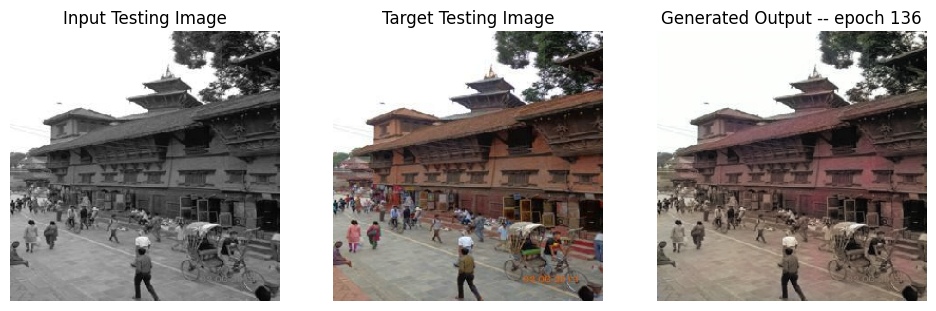

SSIM Score: 0.9786102771759033
PSNR Score: 30.32448959350586
Epoch 136
Training Details
Generator-- total_loss:15.79 gan_loss:7.57 l1_loss:0.03 Discriminator-- total_loss:0.05 real_loss:0.02 generated_loss:0.03 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 137 is 114.50242877006531 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.09 gan_loss:0.21 l1_loss:0.03 Discriminator-- total_loss:2.75 real_loss:2.56 generated_loss:0.19 --- SSIM 0.96 PSNR 25.10
Time taken for epoch 137 is 127.66733908653259 sec
Number of iteration 70: and Lambda = 284.04061747359367
Epoch 137
Training Details
Generator-- total_loss:16.33 gan_loss:8.05 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 138 is 114.3726098537445 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.29 gan_loss:0.34 l1_loss:0.03 Discriminator-- total_loss:2.26 real_loss:1.95 generated_loss:0.31 --- SSIM 0.96 PSNR 25.

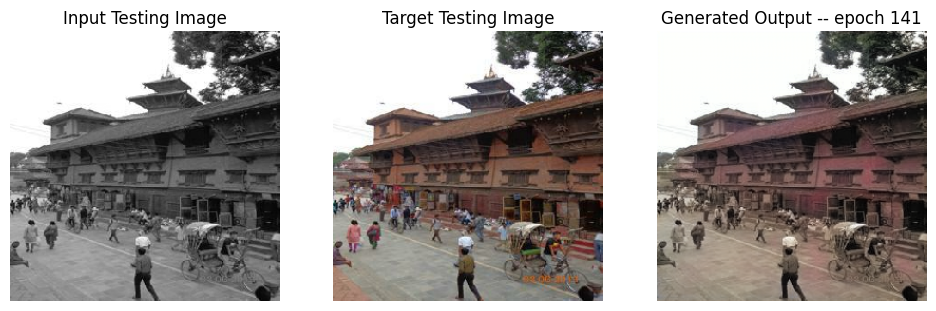

SSIM Score: 0.9786235690116882
PSNR Score: 30.327152252197266
Epoch 141
Training Details
Generator-- total_loss:17.58 gan_loss:9.10 l1_loss:0.03 Discriminator-- total_loss:0.04 real_loss:0.02 generated_loss:0.02 --- SSIM 0.96 PSNR 26.06
Time taken for epoch 142 is 115.6876482963562 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.49 gan_loss:0.29 l1_loss:0.03 Discriminator-- total_loss:2.80 real_loss:2.55 generated_loss:0.25 --- SSIM 0.96 PSNR 25.11
Time taken for epoch 142 is 129.112122297287 sec
Number of iteration 70: and Lambda = 292.6647059906176
Epoch 142
Training Details
Generator-- total_loss:17.81 gan_loss:9.28 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 143 is 115.84174799919128 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.45 gan_loss:0.19 l1_loss:0.03 Discriminator-- total_loss:2.94 real_loss:2.78 generated_loss:0.17 --- SSIM 0.96 PSNR 25.10

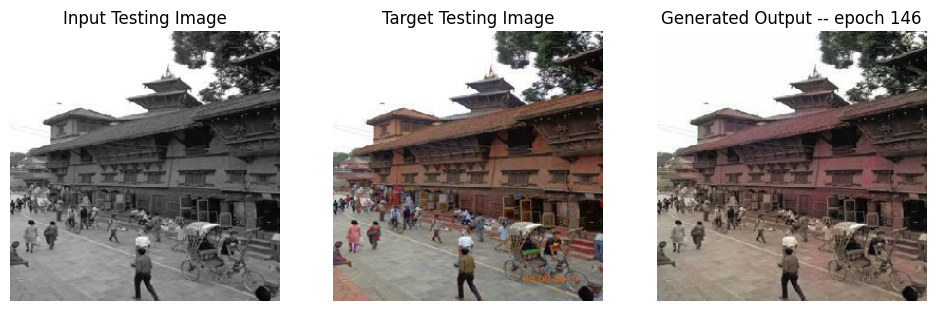

SSIM Score: 0.9786052107810974
PSNR Score: 30.323286056518555
Epoch 146
Training Details
Generator-- total_loss:19.10 gan_loss:10.36 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 147 is 116.42586517333984 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.87 gan_loss:0.37 l1_loss:0.03 Discriminator-- total_loss:2.41 real_loss:2.11 generated_loss:0.31 --- SSIM 0.96 PSNR 25.11
Time taken for epoch 147 is 129.85578060150146 sec
Number of iteration 70: and Lambda = 301.5506405190008
Epoch 147
Training Details
Generator-- total_loss:18.58 gan_loss:9.80 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.08
Time taken for epoch 148 is 115.2093288898468 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.73 gan_loss:0.17 l1_loss:0.03 Discriminator-- total_loss:3.14 real_loss:2.99 generated_loss:0.15 --- SSIM 0.96 PSNR 25

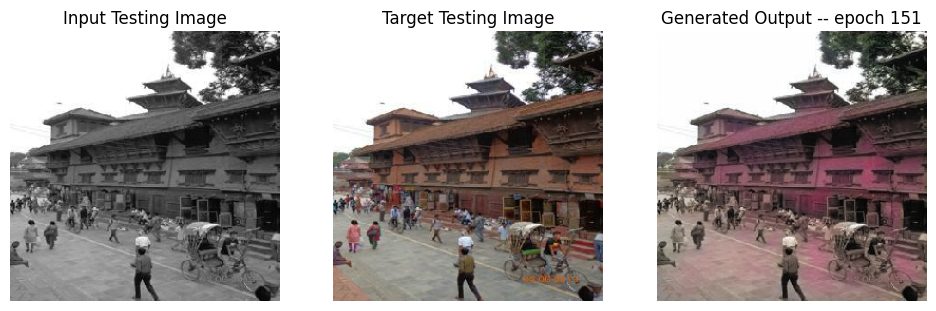

SSIM Score: 0.9733942151069641
PSNR Score: 28.51641845703125
Epoch 151
Training Details
Generator-- total_loss:9.98 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:6.84 real_loss:6.84 generated_loss:0.01 --- SSIM 0.96 PSNR 25.83
Time taken for epoch 152 is 106.46188044548035 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.89 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:8.62 real_loss:8.62 generated_loss:0.00 --- SSIM 0.95 PSNR 24.92
Time taken for epoch 152 is 119.78815364837646 sec
Number of iteration 70: and Lambda = 335.5628809726089
Epoch 152
Training Details
Generator-- total_loss:10.01 gan_loss:0.04 l1_loss:0.03 Discriminator-- total_loss:7.08 real_loss:7.08 generated_loss:0.01 --- SSIM 0.96 PSNR 25.86
Time taken for epoch 153 is 107.24248933792114 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.93 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:8.79 real_loss:8.79 generated_loss:0.00 --- SSIM 0.95 PSNR 24.9

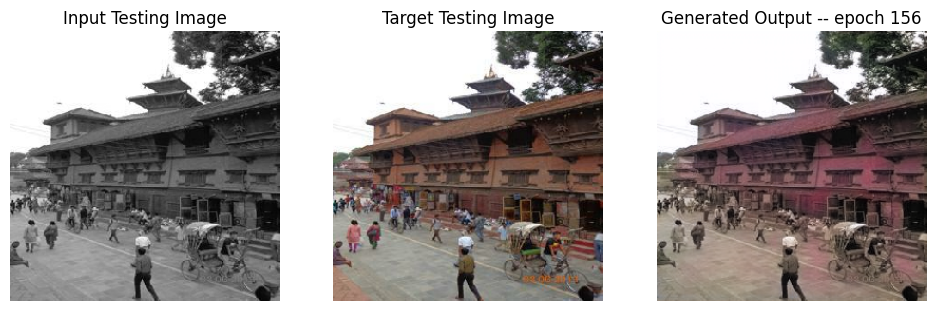

SSIM Score: 0.9764330983161926
PSNR Score: 29.58601951599121
Epoch 156
Training Details
Generator-- total_loss:10.13 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.49 real_loss:7.48 generated_loss:0.01 --- SSIM 0.96 PSNR 26.01
Time taken for epoch 157 is 106.78494572639465 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:12.25 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:9.49 real_loss:9.49 generated_loss:0.00 --- SSIM 0.95 PSNR 25.01
Time taken for epoch 157 is 120.16776728630066 sec
Number of iteration 70: and Lambda = 345.75129703181705
Reduced discriminator learning rate to 7.812500371073838e-06 at epoch 157.
Epoch 157
Training Details
Generator-- total_loss:14.72 gan_loss:3.80 l1_loss:0.03 Discriminator-- total_loss:0.56 real_loss:0.30 generated_loss:0.26 --- SSIM 0.96 PSNR 26.07
Time taken for epoch 158 is 116.82274007797241 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:13.54 gan_loss:0.32 l1_loss:0.04 Discriminator

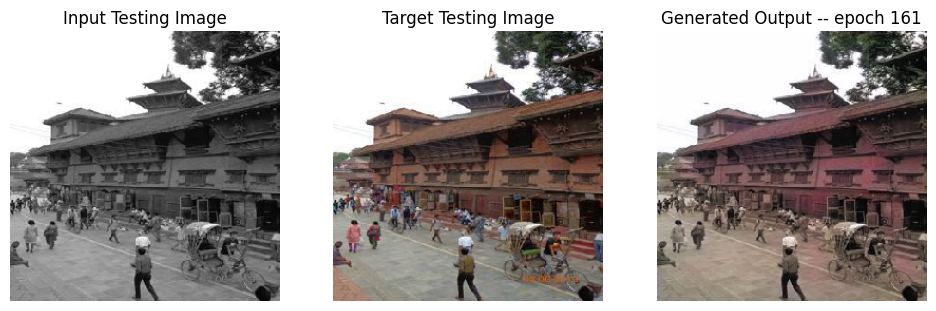

SSIM Score: 0.9775967001914978
PSNR Score: 30.00299835205078
Epoch 161
Training Details
Generator-- total_loss:16.83 gan_loss:5.60 l1_loss:0.03 Discriminator-- total_loss:0.12 real_loss:0.05 generated_loss:0.07 --- SSIM 0.96 PSNR 26.06
Time taken for epoch 162 is 115.90415048599243 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:13.80 gan_loss:0.25 l1_loss:0.04 Discriminator-- total_loss:2.46 real_loss:2.24 generated_loss:0.22 --- SSIM 0.95 PSNR 25.07
Time taken for epoch 162 is 129.2846875190735 sec
Number of iteration 70: and Lambda = 384.7489799137145
Epoch 162
Training Details
Generator-- total_loss:17.10 gan_loss:5.81 l1_loss:0.03 Discriminator-- total_loss:0.09 real_loss:0.04 generated_loss:0.05 --- SSIM 0.96 PSNR 26.05
Time taken for epoch 163 is 116.87538504600525 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:13.96 gan_loss:0.34 l1_loss:0.04 Discriminator-- total_loss:2.10 real_loss:1.82 generated_loss:0.28 --- SSIM 0.95 PSNR 25.0

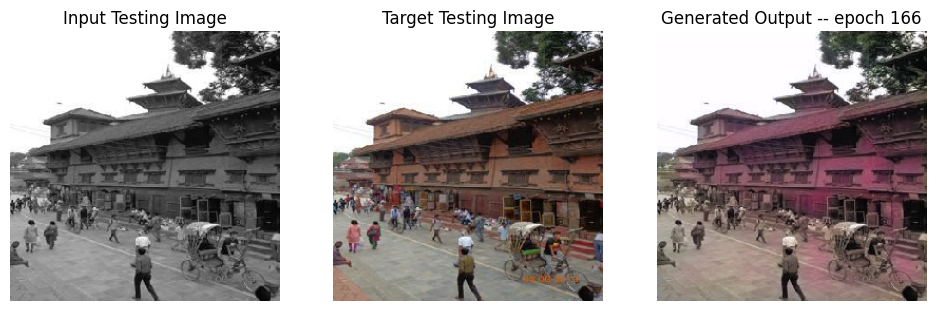

SSIM Score: 0.9729778170585632
PSNR Score: 28.44331932067871
Epoch 166
Training Details
Generator-- total_loss:12.97 gan_loss:0.09 l1_loss:0.03 Discriminator-- total_loss:5.87 real_loss:5.83 generated_loss:0.04 --- SSIM 0.96 PSNR 25.66
Time taken for epoch 167 is 106.41951513290405 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:15.51 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:6.55 real_loss:6.55 generated_loss:0.01 --- SSIM 0.95 PSNR 24.72
Time taken for epoch 167 is 119.76666164398193 sec
Number of iteration 70: and Lambda = 428.1452558976853
Epoch 167
Training Details
Generator-- total_loss:13.02 gan_loss:0.08 l1_loss:0.03 Discriminator-- total_loss:6.02 real_loss:5.98 generated_loss:0.05 --- SSIM 0.96 PSNR 25.68
Time taken for epoch 168 is 106.06157517433167 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:15.50 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:6.58 real_loss:6.57 generated_loss:0.01 --- SSIM 0.95 PSNR 24.

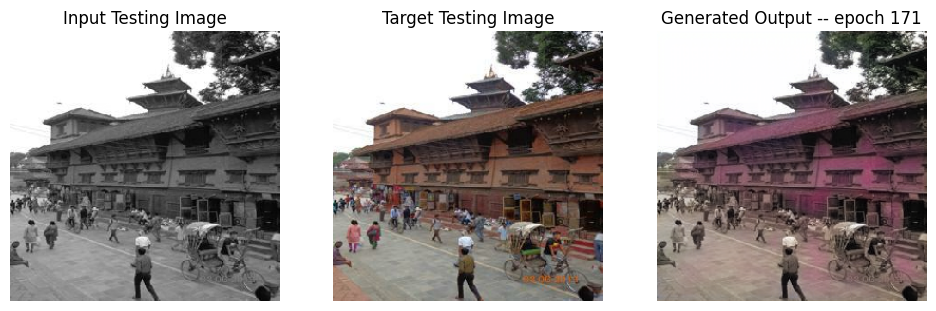

SSIM Score: 0.9740328788757324
PSNR Score: 28.963050842285156
Epoch 171
Training Details
Generator-- total_loss:13.13 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:5.98 real_loss:5.94 generated_loss:0.04 --- SSIM 0.96 PSNR 25.80
Time taken for epoch 172 is 106.43097138404846 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:15.69 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.17 real_loss:7.17 generated_loss:0.01 --- SSIM 0.95 PSNR 24.89
Time taken for epoch 172 is 119.70870041847229 sec
Number of iteration 70: and Lambda = 441.1446734382023
Epoch 172
Training Details
Generator-- total_loss:13.21 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:6.13 real_loss:6.08 generated_loss:0.05 --- SSIM 0.96 PSNR 25.81
Time taken for epoch 173 is 107.05318188667297 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:15.73 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.12 real_loss:7.11 generated_loss:0.01 --- SSIM 0.95 PSNR 24

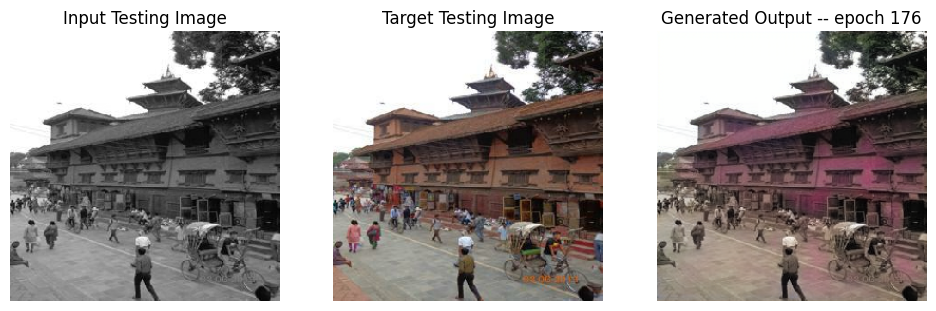

SSIM Score: 0.9752958416938782
PSNR Score: 29.271587371826172
Epoch 176
Training Details
Generator-- total_loss:13.49 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:6.14 real_loss:6.10 generated_loss:0.05 --- SSIM 0.96 PSNR 25.85
Time taken for epoch 177 is 106.80062985420227 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:16.18 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:7.47 real_loss:7.46 generated_loss:0.01 --- SSIM 0.95 PSNR 24.88
Time taken for epoch 177 is 120.40434908866882 sec
Number of iteration 70: and Lambda = 454.5387814583286
Epoch 177
Training Details
Generator-- total_loss:13.54 gan_loss:0.05 l1_loss:0.03 Discriminator-- total_loss:6.25 real_loss:6.19 generated_loss:0.05 --- SSIM 0.96 PSNR 25.85
Time taken for epoch 178 is 106.55593419075012 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:16.15 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:7.59 real_loss:7.58 generated_loss:0.00 --- SSIM 0.95 PSNR 24

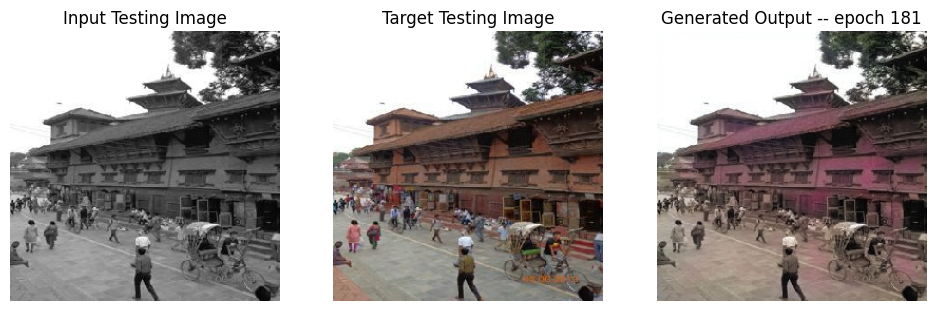

SSIM Score: 0.9764342308044434
PSNR Score: 29.717653274536133
Epoch 181
Training Details
Generator-- total_loss:13.88 gan_loss:0.06 l1_loss:0.03 Discriminator-- total_loss:6.21 real_loss:6.17 generated_loss:0.04 --- SSIM 0.96 PSNR 25.87
Time taken for epoch 182 is 106.82723617553711 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:16.65 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.48 real_loss:7.47 generated_loss:0.01 --- SSIM 0.95 PSNR 24.90
Time taken for epoch 182 is 120.3069200515747 sec
Number of iteration 70: and Lambda = 468.3395636161172
Epoch 182
Training Details
Generator-- total_loss:13.92 gan_loss:0.06 l1_loss:0.03 Discriminator-- total_loss:6.13 real_loss:6.09 generated_loss:0.04 --- SSIM 0.96 PSNR 25.89
Time taken for epoch 183 is 106.57153224945068 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:16.65 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:7.69 real_loss:7.69 generated_loss:0.01 --- SSIM 0.95 PSNR 24.

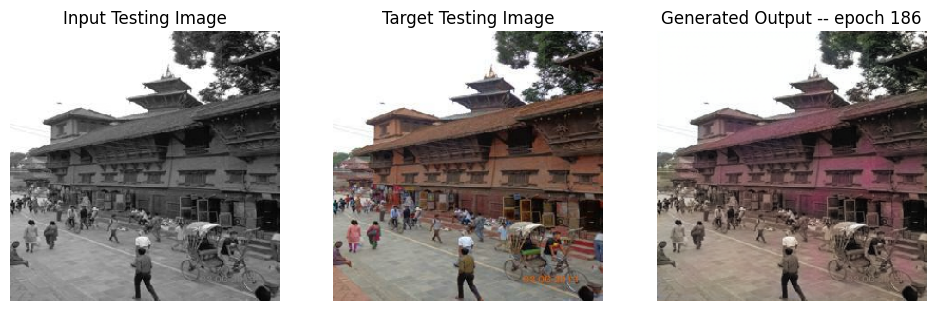

SSIM Score: 0.9769237637519836
PSNR Score: 29.84184455871582
Epoch 186
Training Details
Generator-- total_loss:14.24 gan_loss:0.07 l1_loss:0.03 Discriminator-- total_loss:6.17 real_loss:6.12 generated_loss:0.05 --- SSIM 0.96 PSNR 25.90
Time taken for epoch 187 is 107.15480875968933 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:17.09 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.36 real_loss:7.36 generated_loss:0.01 --- SSIM 0.95 PSNR 24.92
Time taken for epoch 187 is 120.54689931869507 sec
Number of iteration 70: and Lambda = 482.5593674194421
Epoch 187
Training Details
Generator-- total_loss:14.33 gan_loss:0.06 l1_loss:0.03 Discriminator-- total_loss:6.14 real_loss:6.11 generated_loss:0.03 --- SSIM 0.96 PSNR 25.88
Time taken for epoch 188 is 106.56182837486267 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:17.14 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.56 real_loss:7.56 generated_loss:0.01 --- SSIM 0.95 PSNR 24.

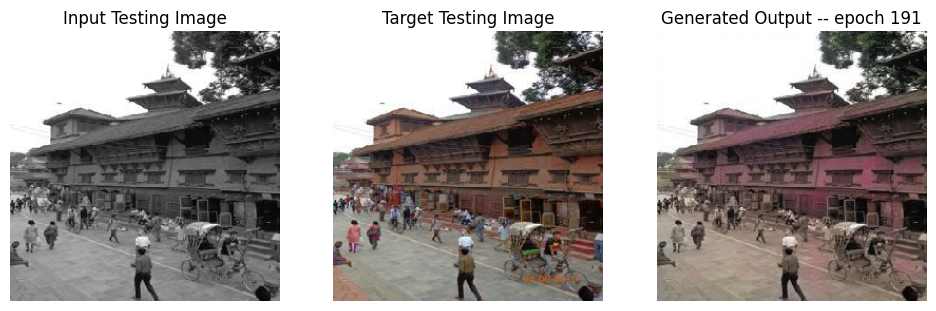

SSIM Score: 0.9774060845375061
PSNR Score: 30.052448272705078
Epoch 191
Training Details
Generator-- total_loss:14.67 gan_loss:0.06 l1_loss:0.03 Discriminator-- total_loss:6.04 real_loss:5.99 generated_loss:0.04 --- SSIM 0.96 PSNR 25.89
Time taken for epoch 192 is 107.27872467041016 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:17.55 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.53 real_loss:7.52 generated_loss:0.01 --- SSIM 0.95 PSNR 24.95
Time taken for epoch 192 is 120.70863461494446 sec
Number of iteration 70: and Lambda = 497.210915273267
Epoch 192
Training Details
Generator-- total_loss:14.76 gan_loss:0.07 l1_loss:0.03 Discriminator-- total_loss:6.01 real_loss:5.97 generated_loss:0.04 --- SSIM 0.96 PSNR 25.88
Time taken for epoch 193 is 107.39494061470032 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:17.70 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.48 real_loss:7.47 generated_loss:0.01 --- SSIM 0.95 PSNR 24.

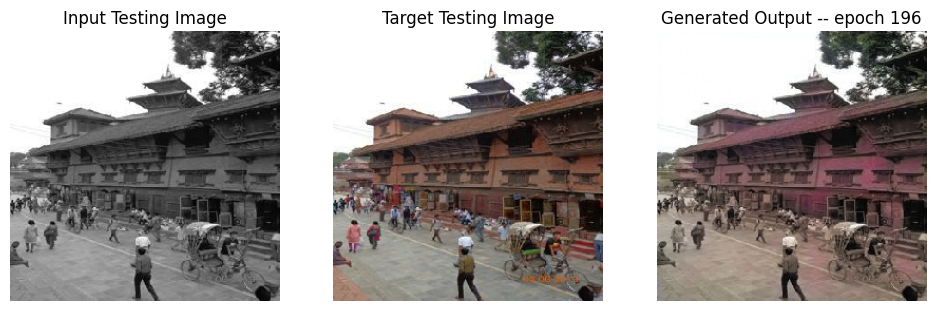

SSIM Score: 0.9773545861244202
PSNR Score: 30.0170955657959
Epoch 196
Training Details
Generator-- total_loss:15.11 gan_loss:0.06 l1_loss:0.03 Discriminator-- total_loss:6.09 real_loss:6.04 generated_loss:0.05 --- SSIM 0.96 PSNR 25.89
Time taken for epoch 197 is 106.66504263877869 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:18.13 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:7.56 real_loss:7.55 generated_loss:0.01 --- SSIM 0.95 PSNR 24.93
Time taken for epoch 197 is 120.1001341342926 sec
Number of iteration 70: and Lambda = 512.3073158623334
Epoch 197
Training Details
Generator-- total_loss:15.19 gan_loss:0.07 l1_loss:0.03 Discriminator-- total_loss:6.03 real_loss:5.98 generated_loss:0.05 --- SSIM 0.96 PSNR 25.90
Time taken for epoch 198 is 108.0732274055481 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:18.22 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.36 real_loss:7.35 generated_loss:0.01 --- SSIM 0.95 PSNR 24.95


In [41]:
fit(train_dataset, epochs, test_dataset, gen)

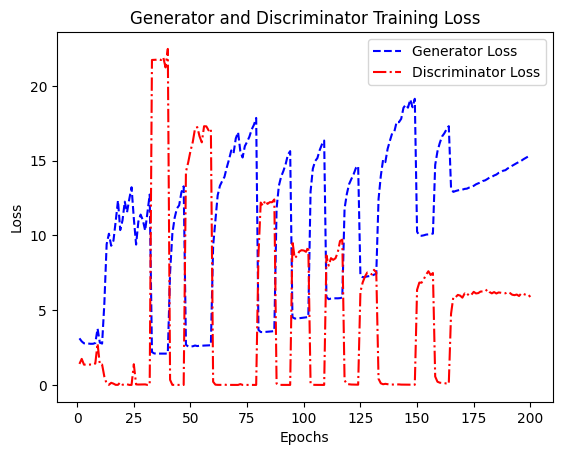

In [42]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, train_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/train_loss_plot_1.png')
plt.show()

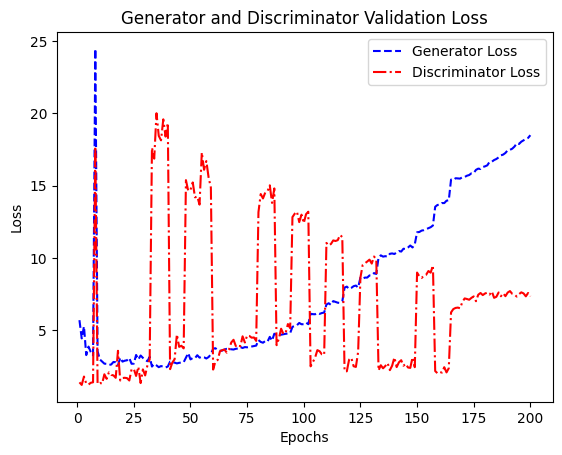

In [43]:
epochs = range(1, len(test_generator_losses) + 1)

plt.plot(epochs, test_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/test_loss_plot_1.png')
plt.show()

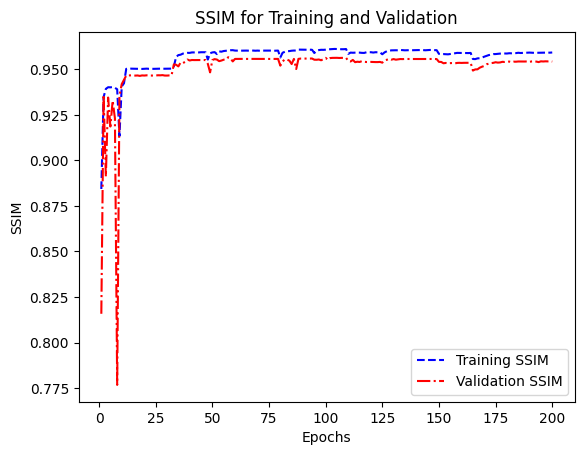

In [44]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_ssim, '--b', label='Training SSIM')
plt.plot(epochs, testing_ssim, '-.r', label='Validation SSIM')
plt.title('SSIM for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('/kaggle/working/SSIM_plot_1.png')
plt.show()

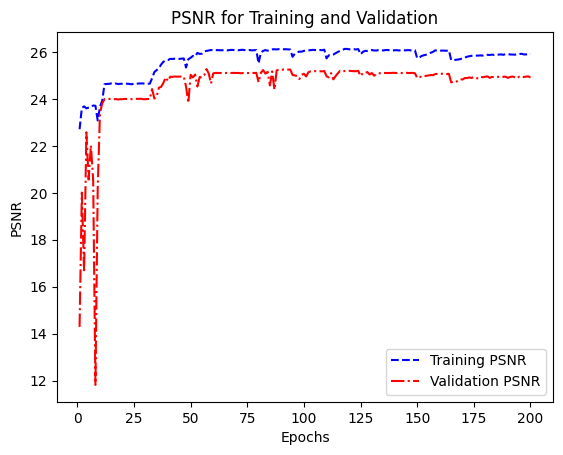

In [45]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_psnr, '--b', label='Training PSNR')
plt.plot(epochs, testing_psnr, '-.r', label='Validation PSNR')
plt.title('PSNR for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('PSNR')
plt.legend()
plt.savefig('/kaggle/working/PSNR_plot_1.png')
plt.show()

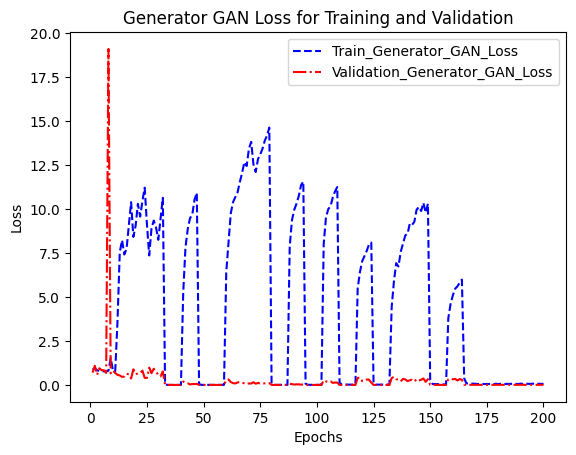

In [46]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Train_Generator_GAN_Loss')
plt.plot(epochs, test_generator_gan_losses, '-.r', label='Validation_Generator_GAN_Loss')
plt.title('Generator GAN Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_GAN_plot_1.png')
plt.show()

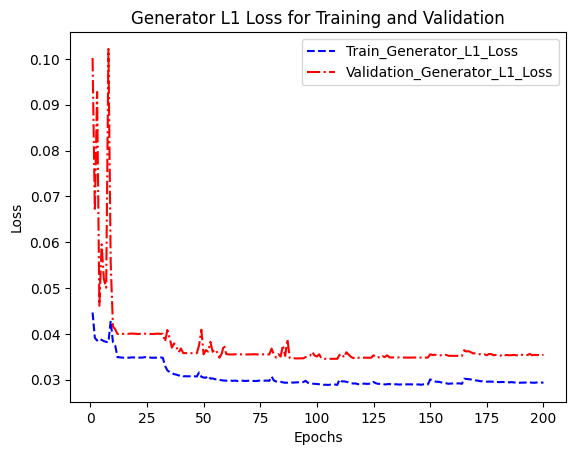

In [47]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l1_losses, '--b', label='Train_Generator_L1_Loss')
plt.plot(epochs, test_generator_l1_losses, '-.r', label='Validation_Generator_L1_Loss')
plt.title('Generator L1 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L1_plot_1.png')
plt.show()

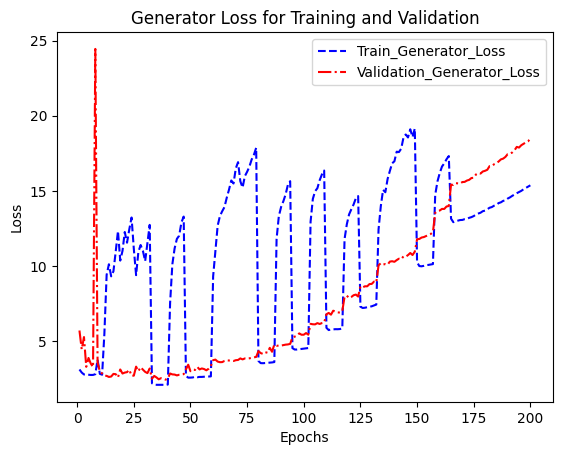

In [48]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Train_Generator_Loss')
plt.plot(epochs, test_generator_losses, '-.r', label='Validation_Generator_Loss')
plt.title('Generator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_plot_1.png')
plt.show()

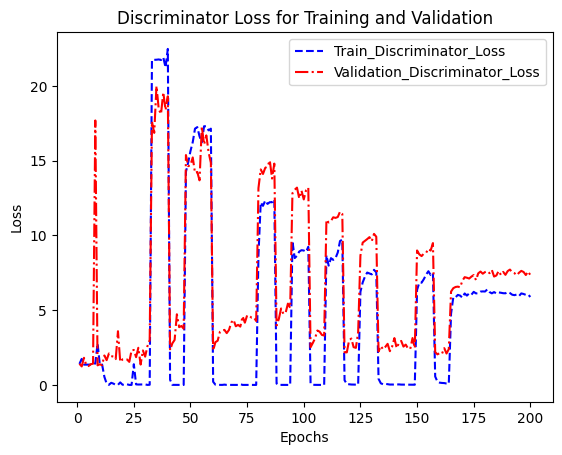

In [49]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_losses, '--b', label='Train_Discriminator_Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Validation_Discriminator_Loss')
plt.title('Discriminator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_plot_1.png')
plt.show()

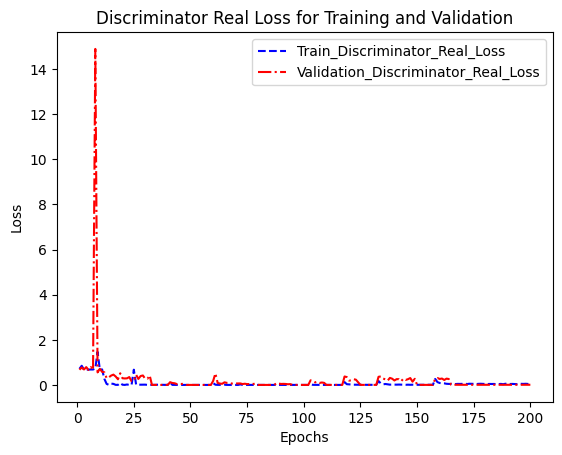

In [50]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_real_losses, '--b', label='Train_Discriminator_Real_Loss')
plt.plot(epochs, test_discriminator_real_losses, '-.r', label='Validation_Discriminator_Real_Loss')
plt.title('Discriminator Real Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Real_plot_1.png')
plt.show()

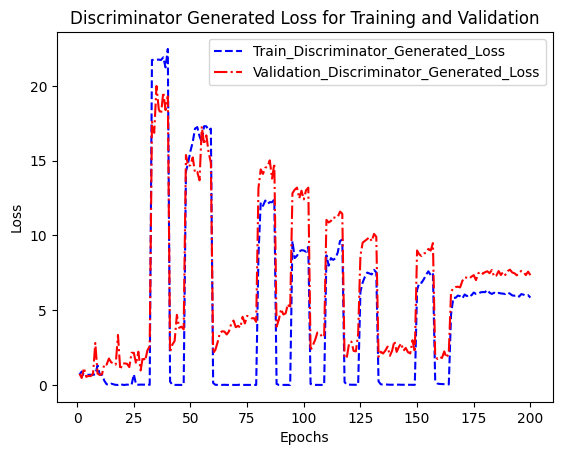

In [51]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_generated_losses, '--b', label='Train_Discriminator_Generated_Loss')
plt.plot(epochs, test_discriminator_generated_losses, '-.r', label='Validation_Discriminator_Generated_Loss')
plt.title('Discriminator Generated Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Generated_plot_1.png')
plt.show()

In [52]:
import csv
with open('/kaggle/working/dataJan20.csv','w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(all_records)

In [53]:
os.mkdir('/kaggle/working/modelsJan20')

In [54]:
gen.save('/kaggle/working/modelsJan20/gen.h5')
gen.save_weights('/kaggle/working/modelsJan20/gen.keras')
disc.save('/kaggle/working/modelsJan20/disc.h5')
disc.save_weights('/kaggle/working/modelsJan20/disc.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [55]:
def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode !=0:
        print("Unable to run zip command")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [56]:
import subprocess
from IPython.display import FileLink, display

In [57]:
download_file('/kaggle/working', 'outputJan20')

/kaggle/working/outputJan20.zip